# S1D1 - ADT of CITE-seq data

This notebook contains the preprocessing of the ADT part of the CITE-seq data sets. ADT stands for antibody derived tag and each antibody in the used panel binds to a specific protein on the cell surface. The counts correlate to the amount of protein present on the surface. If you've spend some time in labs, this can be closely related to FACS, which also uses surface proteins to define celltypes.

In [1]:
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy as sp

import os

In [2]:
sc.set_figure_params(scanpy=True, dpi=60, dpi_save=250,
                     frameon=False,
                     color_map="YlGnBu", format='pdf', transparent=False,
                     ipython_format='png2x', figsize=(7,7))

In [3]:
sc.logging.print_header()

scanpy==1.7.2 anndata==0.7.6 umap==0.5.1 numpy==1.20.3 scipy==1.7.1 pandas==1.2.5 scikit-learn==0.24.2 statsmodels==0.12.2 python-igraph==0.9.6 louvain==0.7.0


# Test R methods

Note: you might have to set your `.libPaths()` variable to only track the libraries from your conda environment. This can be done by writing something like the following into a jupyter cell:

```
%R .libPaths(.libPaths()c[3,2])
```

The `c[3,2]` should be altered here to give priority to the relevant libraries. Note that the first library is given priority (in this example, the library originally in 3rd position in the `.libPaths()` output.

In [4]:
import rpy2.rinterface_lib.callbacks
import logging
from rpy2.robjects import pandas2ri
import anndata2ri

# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

# Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

In [5]:
%R library(Seurat)

'SeuratOb...,'Seurat','tools',...,'datasets','methods','base'


# Load raw data

Downloaded from
```
s3://openproblems-bio/neurips2021/site1/production/donor01.lot3054455/cite/cellranger_out/filtered_feature_bc_matrix.h5
```

# S1D1 - GEX of CITE-seq data sets

In [6]:
os.getcwd()

'/home/jovyan/project/neurips2021-notebooks-private/notebooks/analysis/cite/s1d1'

In [7]:
os.chdir('/home/jovyan/project/neurips2021-notebooks-private/')

In [8]:
adata = sc.read_10x_h5('data/s1d1/cite/raw_data/filtered_feature_bc_matrix.h5', gex_only=False)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [9]:
adata.var['feature_types'].value_counts()

Gene Expression     36601
Antibody Capture      140
Name: feature_types, dtype: int64

In [10]:
adata_adt = adata[:,adata.var['feature_types'].isin(['Antibody Capture'])].copy()
#adata_gex = adata[:,adata.var['feature_types'].isin(['Gene Expression'])].copy()

In [11]:
del adata

In [12]:
adata_adt

AnnData object with n_obs × n_vars = 8785 × 140
    var: 'gene_ids', 'feature_types', 'genome'

## QC

### Metric description

- **total_counts:** Total number of ADTs in each cell: Should be chosen permissivly since the biological state of a cell can largly influence the amount of proteins present on the surface. Extremely low might indicate sequencing problems, extremly high might indicate the presence of antibodies "clumps" that got trapped in the droplet
- **n_antibodies_by_counts:** Number of Anibodies captured: Also choose permissively
- **iso_count:** Number of reads from non-specific antibodies: Low counts might indicate cell/sequencing issues independent of biological state. This metric is less useful though if experiment was successful and there was hardly any non-specific binding.

In [13]:
sc.pp.calculate_qc_metrics(
    adata_adt,
    percent_top=(5,10),
    var_type="antibodies",
    inplace=True,
)

In [14]:
iso_abs = [a for a in adata_adt.var_names if any(['Mouse' in a, 'Rat' in a])]

In [15]:
iso_count = list(adata_adt[:,iso_abs].X.toarray().sum(axis=1))

In [16]:
adata_adt.obs['iso_count'] = iso_count

In [17]:
#generate count for coloring
adata_adt.obs['iso_count_col'] = [c if c < np.percentile(iso_count, 99) else np.percentile(iso_count, 99)+1 for c in iso_count] 
adata_adt.obs['log_iso_count'] = np.log10(iso_count)

/tmp/ipykernel_616/915588432.py:3: RuntimeWarning: divide by zero encountered in log10
  adata_adt.obs['log_iso_count'] = np.log10(iso_count)


In [18]:
adata_adt

AnnData object with n_obs × n_vars = 8785 × 140
    obs: 'n_antibodies_by_counts', 'log1p_n_antibodies_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_5_antibodies', 'pct_counts_in_top_10_antibodies', 'iso_count', 'iso_count_col', 'log_iso_count'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [19]:
adata_adt.obs.head()

,n_antibodies_by_counts,log1p_n_antibodies_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_5_antibodies,pct_counts_in_top_10_antibodies,iso_count,iso_count_col,log_iso_count
AAACCCAAGGATGGCT-1,124,4.828314,6483.0,8.777093,32.608360,53.000154,12.0,12.0,1.079181
AAACCCAAGGCCTAGA-1,140,4.948760,19711.0,9.888983,33.965806,50.048196,35.0,35.0,1.544068
AAACCCAAGTGAGTGC-1,120,4.795791,3349.0,8.116715,35.801732,54.523738,9.0,9.0,0.954243
AAACCCACAAGAGGCT-1,128,4.859812,7841.0,8.967249,50.618544,66.713429,8.0,8.0,0.903090
AAACCCACATCGTGGC-1,114,4.744932,2462.0,7.809135,43.135662,59.748172,0.0,0.0,-inf


In [20]:
# colors for highlighting min and max isocounts

from matplotlib import colors

colors1 = plt.cm.Blues_r(np.linspace(0, 0.1, 1))
colors2 = plt.cm.Reds(np.linspace(0, 1, 98))
colors3 = plt.cm.Purples_r(np.linspace(0,0.1,1))
colorsComb = np.vstack([colors1, colors2, colors3])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)


... storing 'feature_types' as categorical
... storing 'genome' as categorical


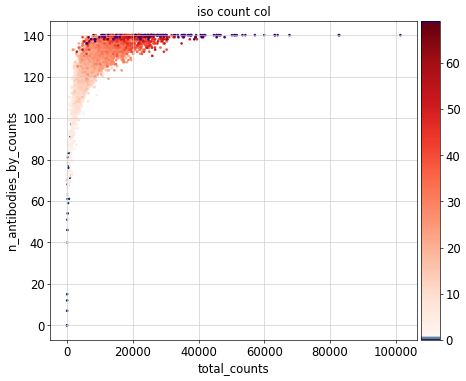

In [21]:
p1 = sc.pl.scatter(adata_adt,'total_counts', 'n_antibodies_by_counts',
                   color = 'iso_count_col', size=40, show=False, color_map=mymap)

plt.show()

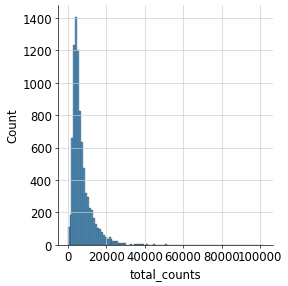

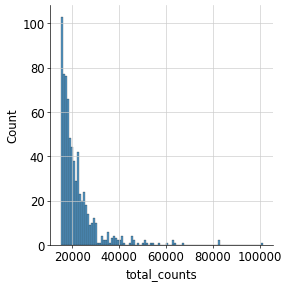

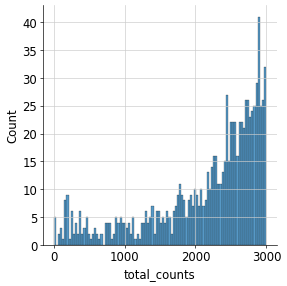

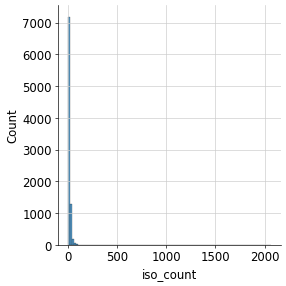

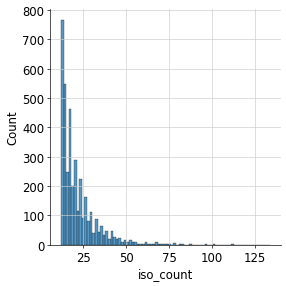

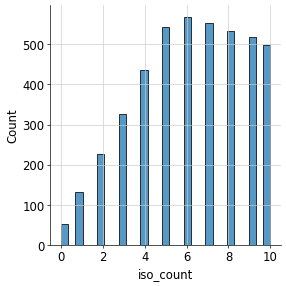

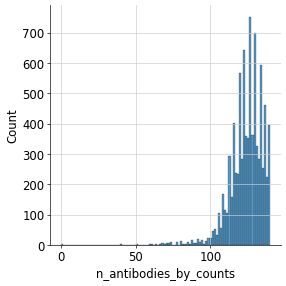

In [22]:
t1 = sns.displot(adata_adt.obs['total_counts'], bins=100, kde=False)
t2 = sns.displot(adata_adt.obs.loc[adata_adt.obs['total_counts']>15000,'total_counts'], bins=100, kde=False)
t2 = sns.displot(adata_adt.obs.loc[adata_adt.obs['total_counts']<3000,'total_counts'], bins=100, kde=False)

t3 = sns.displot(adata_adt.obs['iso_count'], bins=100, kde=False)
#t4 = sns.displot(adata_adt.obs['log_iso_count'], bins=100, kde=False)
t6 = sns.displot(adata_adt.obs.loc[np.logical_and(adata_adt.obs['iso_count'] > np.percentile(iso_count, 50),
                                   adata_adt.obs['iso_count'] < np.percentile(iso_count, 99.5)),'iso_count'], bins=80, kde=False)
t7 = sns.displot(adata_adt.obs.loc[adata_adt.obs['iso_count'] < np.percentile(iso_count, 50),'iso_count'], bins=29, kde=False)

t8 = sns.displot(adata_adt.obs['n_antibodies_by_counts'], bins=100, kde=False)

plt.show()

The plots above show that the quality of the ADT data is high since hardly any unspecific binding could take place in almost all cells. We therefore only filter out very high and low counts and cells with less than 80 captured antibodies. We use the isotype control only to filter out cells with 0 counts and more then 100 iso-ADT counts, in case it is cells containing antibody clusters.
In general we can fiter out a bit more on the high count side, since these might correspond to doublets.

... storing 'iso_count_fltr' as categorical


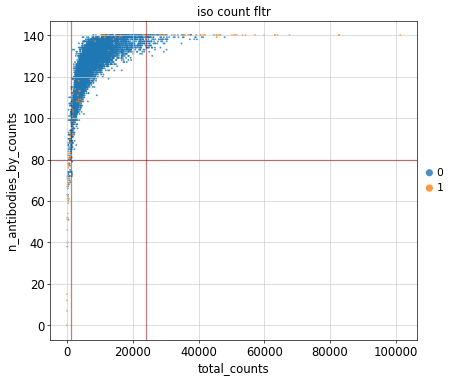

In [23]:
lower_count_thresh = 1200 #1200 #(700)
upper_counts_thresh = 24000 # 27500 #31500 #31500
lower_features_thresh = 80

lower_iso_count_thresh = 0
upper_iso_count_thresh = 100

# color by iso count filter
adata_adt.obs['iso_count_fltr'] = ['0' if (c > lower_iso_count_thresh and c < upper_iso_count_thresh) else '1' for c in adata_adt.obs.iso_count]

p2 = sc.pl.scatter(adata_adt, 'total_counts', 'n_antibodies_by_counts', \
                   color = 'iso_count_fltr', size=20, show=False, alpha=0.8)

p2.axline((lower_count_thresh,0),(lower_count_thresh,1), color='darkred', alpha=0.5)
p2.axline((upper_counts_thresh,0),(upper_counts_thresh,1), color='darkred', alpha=0.5)
p2.axline((0,lower_features_thresh),(1,lower_features_thresh), color='darkred', alpha=0.5)
plt.show()

# Filter cells

In [24]:
adata_bkp = adata_adt.copy()
#adata_adt = adata_bkp.copy()

In [25]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata_adt.n_obs))

sc.pp.filter_cells(adata_adt, min_counts = lower_count_thresh)
print('Number of cells after min count filter: {:d}'.format(adata_adt.n_obs))

sc.pp.filter_cells(adata_adt, max_counts = upper_counts_thresh)
print('Number of cells after max count filter: {:d}'.format(adata_adt.n_obs))

adata_adt = adata_adt[adata_adt.obs['n_antibodies_by_counts'] > lower_features_thresh]
print('Number of cells after n_feature filter: {:d}'.format(adata_adt.n_obs))

adata_adt = adata_adt[adata_adt.obs['iso_count_fltr'] == '0']
print('Number of cells after iso_count filter: {:d}'.format(adata_adt.n_obs))


Total number of cells: 8785
Number of cells after min count filter: 8659
Number of cells after max count filter: 8492
Number of cells after n_feature filter: 8488
Number of cells after iso_count filter: 8455


In [26]:
# check if any antibody is detected in less than 20 cells
min(adata_adt.var.n_cells_by_counts)

3683

# Normalization - CLR implementation from Seurat

In [27]:
# Save raw counts
adata_adt.layers['counts'] = adata_adt.X.copy()

In [28]:
#Prepare for R input
cell_ids = adata_adt.obs_names
gene_ids = adata_adt.var_names

mat = adata_adt.X.T.A
mat_df = pd.DataFrame(mat, index=gene_ids, columns=cell_ids)

In [29]:
%%R -i mat_df -o norm_mat

counts <- mat_df
cbmc <- CreateSeuratObject(counts = counts, assay='ADT')
cbmc <- NormalizeData(cbmc, normalization.method = "CLR", margin = 2)

norm_mat <- cbmc[['ADT']]@data

  |                                                  | 0 % ~calculating   |+                                                 | 0 % ~34s           |+                                                 | 0 % ~30s           |+                                                 | 0 % ~28s           |+                                                 | 0 % ~25s           |+                                                 | 0 % ~25s           |+                                                 | 0 % ~24s           |+                                                 | 0 % ~25s           |+                                                 | 0 % ~24s           |+                                                 | 0 % ~23s           |+                                                 | 0 % ~24s           |+                                                 | 0 % ~24s           |+                                                 | 0 % ~24s           |+                                                 | 0 % ~24s 

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



 18% ~25s           |++++++++++                                        | 18% ~25s           |++++++++++                                        | 18% ~25s           |++++++++++                                        | 18% ~25s           |++++++++++                                        | 18% ~25s           |++++++++++                                        | 18% ~25s           |++++++++++                                        | 18% ~25s           |++++++++++                                        | 18% ~25s           |++++++++++                                        | 18% ~25s           |++++++++++                                        | 18% ~25s           |++++++++++                                        | 18% ~25s           |++++++++++                                        | 18% ~25s           |++++++++++                                        | 18% ~25s           |++++++++++                                        | 18% ~25s           |++++++++++                                 

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



  |+++++++++++++++++++++                             | 41% ~17s           |+++++++++++++++++++++                             | 41% ~17s           |+++++++++++++++++++++                             | 41% ~17s           |+++++++++++++++++++++                             | 41% ~17s           |+++++++++++++++++++++                             | 41% ~17s           |+++++++++++++++++++++                             | 41% ~17s           |+++++++++++++++++++++                             | 41% ~17s           |+++++++++++++++++++++                             | 41% ~17s           |+++++++++++++++++++++                             | 41% ~17s           |+++++++++++++++++++++                             | 41% ~17s           |+++++++++++++++++++++                             | 41% ~17s           |+++++++++++++++++++++                             | 41% ~17s           |+++++++++++++++++++++                             | 41% ~17s           |+++++++++++++++++++++                             | 41% ~17s 

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



 |+++++++++++++++++++++++++                         | 49% ~14s           |+++++++++++++++++++++++++                         | 49% ~14s           |+++++++++++++++++++++++++                         | 49% ~14s           |+++++++++++++++++++++++++                         | 49% ~14s           |+++++++++++++++++++++++++                         | 49% ~14s           |+++++++++++++++++++++++++                         | 49% ~14s           |+++++++++++++++++++++++++                         | 50% ~14s           |+++++++++++++++++++++++++                         | 50% ~14s           |+++++++++++++++++++++++++                         | 50% ~14s           |+++++++++++++++++++++++++                         | 50% ~14s           |+++++++++++++++++++++++++                         | 50% ~14s           |+++++++++++++++++++++++++                         | 50% ~14s           |+++++++++++++++++++++++++                         | 50% ~14s           |+++++++++++++++++++++++++                         | 50% ~14s  

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



  |++++++++++++++++++++++++++++++                    | 60% ~11s           |++++++++++++++++++++++++++++++                    | 60% ~11s           |++++++++++++++++++++++++++++++                    | 60% ~11s           |++++++++++++++++++++++++++++++                    | 60% ~11s           |++++++++++++++++++++++++++++++                    | 60% ~11s           |++++++++++++++++++++++++++++++                    | 60% ~11s           |++++++++++++++++++++++++++++++                    | 60% ~11s           |++++++++++++++++++++++++++++++                    | 60% ~11s           |++++++++++++++++++++++++++++++                    | 60% ~11s           |++++++++++++++++++++++++++++++                    | 60% ~11s           |++++++++++++++++++++++++++++++                    | 60% ~11s           |++++++++++++++++++++++++++++++                    | 60% ~11s           |++++++++++++++++++++++++++++++                    | 60% ~11s           |++++++++++++++++++++++++++++++                    | 60% ~11s 

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



 69% ~09s           |+++++++++++++++++++++++++++++++++++               | 69% ~09s           |+++++++++++++++++++++++++++++++++++               | 69% ~09s           |+++++++++++++++++++++++++++++++++++               | 69% ~09s           |+++++++++++++++++++++++++++++++++++               | 69% ~09s           |+++++++++++++++++++++++++++++++++++               | 69% ~09s           |+++++++++++++++++++++++++++++++++++               | 69% ~09s           |+++++++++++++++++++++++++++++++++++               | 69% ~09s           |+++++++++++++++++++++++++++++++++++               | 69% ~09s           |+++++++++++++++++++++++++++++++++++               | 69% ~09s           |+++++++++++++++++++++++++++++++++++               | 69% ~09s           |+++++++++++++++++++++++++++++++++++               | 69% ~09s           |+++++++++++++++++++++++++++++++++++               | 69% ~09s           |+++++++++++++++++++++++++++++++++++               | 69% ~09s           |+++++++++++++++++++++++++++++++++++        

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



 0% ~06s           |+++++++++++++++++++++++++++++++++++++++++         | 80% ~06s           |+++++++++++++++++++++++++++++++++++++++++         | 80% ~06s           |+++++++++++++++++++++++++++++++++++++++++         | 80% ~06s           |+++++++++++++++++++++++++++++++++++++++++         | 80% ~06s           |+++++++++++++++++++++++++++++++++++++++++         | 80% ~06s           |+++++++++++++++++++++++++++++++++++++++++         | 80% ~06s           |+++++++++++++++++++++++++++++++++++++++++         | 80% ~06s           |+++++++++++++++++++++++++++++++++++++++++         | 80% ~06s           |+++++++++++++++++++++++++++++++++++++++++         | 80% ~06s           |+++++++++++++++++++++++++++++++++++++++++         | 80% ~06s           |+++++++++++++++++++++++++++++++++++++++++         | 80% ~06s           |+++++++++++++++++++++++++++++++++++++++++         | 80% ~06s           |+++++++++++++++++++++++++++++++++++++++++         | 80% ~05s           |+++++++++++++++++++++++++++++++++++++++++   

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



  |++++++++++++++++++++++++++++++++++++++++++++++    | 91% ~03s           |++++++++++++++++++++++++++++++++++++++++++++++    | 91% ~03s           |++++++++++++++++++++++++++++++++++++++++++++++    | 91% ~03s           |++++++++++++++++++++++++++++++++++++++++++++++    | 91% ~03s           |++++++++++++++++++++++++++++++++++++++++++++++    | 91% ~03s           |++++++++++++++++++++++++++++++++++++++++++++++    | 91% ~03s           |++++++++++++++++++++++++++++++++++++++++++++++    | 91% ~03s           |++++++++++++++++++++++++++++++++++++++++++++++    | 91% ~03s           |++++++++++++++++++++++++++++++++++++++++++++++    | 91% ~03s           |++++++++++++++++++++++++++++++++++++++++++++++    | 91% ~03s           |++++++++++++++++++++++++++++++++++++++++++++++    | 91% ~03s           |++++++++++++++++++++++++++++++++++++++++++++++    | 91% ~03s           |++++++++++++++++++++++++++++++++++++++++++++++    | 91% ~03s           |++++++++++++++++++++++++++++++++++++++++++++++    | 91% ~03s 

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [30]:
adata_adt.X = norm_mat.T

In [31]:
#sc.pp.scale(adata_minR, max_value=10)

In [32]:
sc.pp.pca(adata_adt, n_comps=50)

In [33]:
sc.pp.neighbors(adata_adt, n_neighbors=20)

In [34]:
sc.tl.leiden(adata_adt)

In [35]:
sc.tl.umap(adata_adt)

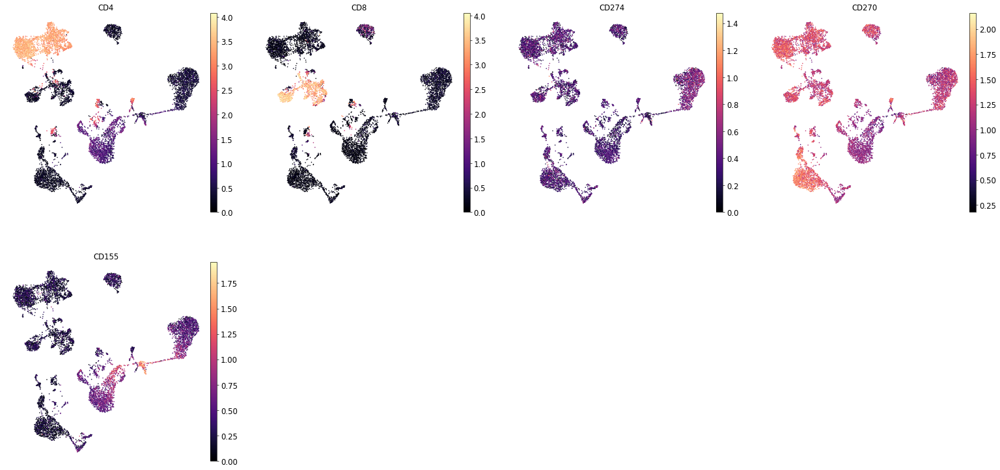

In [36]:
# plot few markers to check output
sc.pl.umap(adata_adt, color=['CD4','CD8', 'CD274', 'CD270','CD155'], color_map ='magma') #,'Rat-IgG1','Mouse-IgG2a'

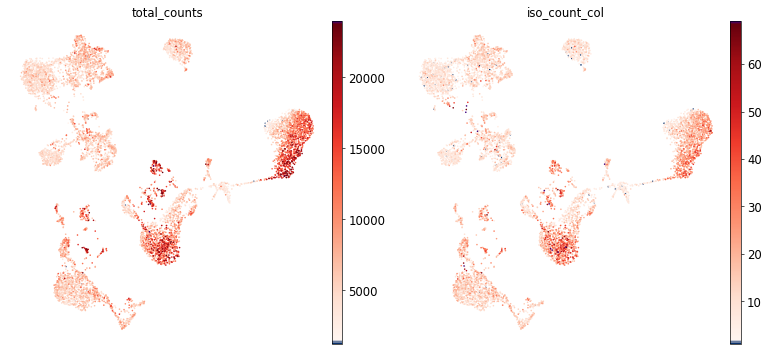

In [37]:
sc.pl.umap(adata_adt, color=['total_counts', 'iso_count_col'], color_map=mymap)

There's a very clear separation between CD4 and CD8 T cells with additional substructure.
The lower plots indicate some cell clusters in the middle high counts, potentially indicating doublet. This we will assess by marker gene expression.

# Clustering

Let the fun begin! First step, cluster at several resolutions and select the resolution that broadly captures the structure you see in the UMAP. Try to avoid getting into detailed substructure already at this early stage.

In [38]:
sc.tl.leiden(adata_adt, resolution=0.3, key_added='leiden_res0.3')
sc.tl.leiden(adata_adt, resolution=0.5, key_added='leiden_res0.5')
sc.tl.leiden(adata_adt, resolution=0.8, key_added='leiden_res0.8')
sc.tl.leiden(adata_adt, resolution=1, key_added='leiden_res1')

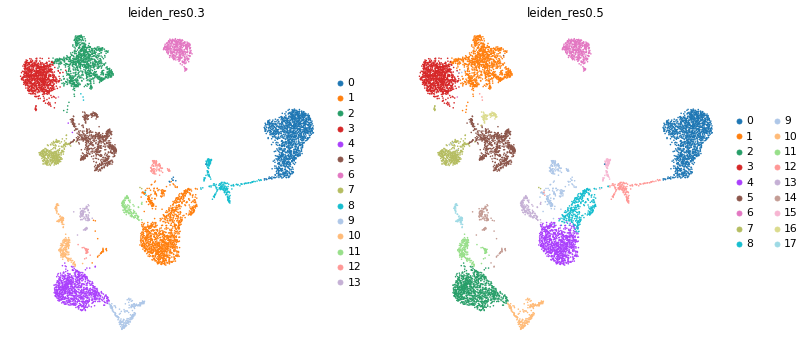

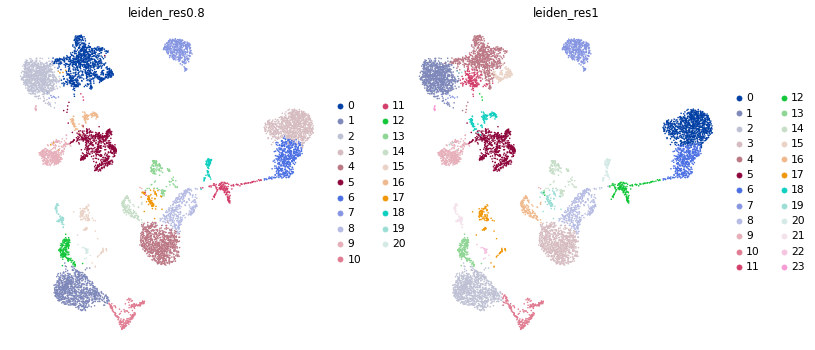

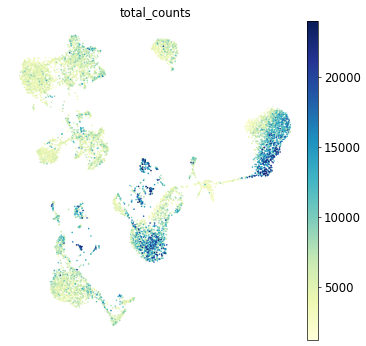

In [39]:
sc.pl.umap(adata_adt, color=['leiden_res0.3', 'leiden_res0.5'])
sc.pl.umap(adata_adt, color=['leiden_res0.8', 'leiden_res1'])
sc.pl.umap(adata_adt, color='total_counts')

### Choose initial resolution

In [40]:
# choose initial clustering resolition here:

orig_res = 'leiden_res0.5'

Check which clusters have the problematic aggregation of high-count cells... these might be difficult to annotate and could be doublets.

# Doublet detection

Doublet detection to gain extra evidence for which cells are actually two separate cells that happen to be assigned to the same barcode (doublets).
Note that for GEX data it is recommended to use raw counts as an input. In ADT data, this only returnes a very low number of cells with high doublet scores. When using the CLR transformed data, the number of predicted doublets becomes much closer to what we would expect (around 8-10 % for 8-9 thousand cells).

In [41]:
test_dat = adata_adt.copy()
#test_dat.X = test_dat.layers['counts']

In [42]:
sc.external.pp.scrublet(test_dat, n_prin_comps=24, expected_doublet_rate = 0.08)

/srv/conda/envs/saturn/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.24
Detected doublet rate = 4.8%
Estimated detectable doublet fraction = 80.0%
Overall doublet rate:
	Expected   = 8.0%
	Estimated  = 6.0%


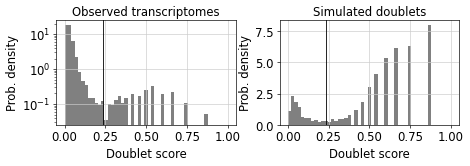

In [43]:
sc.external.pl.scrublet_score_distribution(test_dat)

plt.show()

The distribution of simulated doublets show that potentially a score over 0.25 is already indicative of a doublet. Note that not all doublets will be detectable in this way and it will be more valuable to remove entire clusters based on these scores.

In [44]:
adata_adt.obs['doublet_score'] = test_dat.obs['doublet_score']
adata_adt.obs['predicted_doublet'] = test_dat.obs['predicted_doublet'].astype(str)

In [45]:
del test_dat

... storing 'predicted_doublet' as categorical


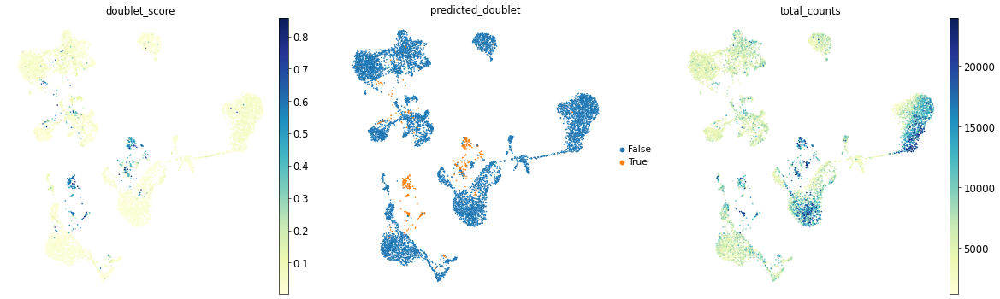

In [46]:
sc.pl.umap(adata_adt, color=['doublet_score', 'predicted_doublet', 'total_counts'])

# Marker proteins

In [59]:
high_level_markers = {
    'Erythro linage' : ['CD71'],
    'CD4+ T' : ['CD4'],
    'CD8+ T' : ['CD8'],
    'B': ['CD40', 'CD19'],
    'Mono':['CD11b'],
    'Progen':['CD112']
}

In [60]:
marker_prots = {
    
    'CD14+ Mono': ['CD14', 'CD11b', 'CD62P'],
    'CD16+ Mono': ['CD85j', 'CD11c', 'CD172a', 'CD88'],
    'cDC2': ['CD1c', 'FceRIa', 'CD11c'],
    'pDC': ['CD303', 'CD304'], 
    
    #Ery linage
    'Proerythroblast': ['CD105'],
    'Erythroblast': ['CD82', 'CD71'], # CD82 also in B
    'Normoblast/Reticulocyte': ['CD71'], 

    # B linage
    'naive CD20+ B': ['IgD'],
    'B1 B': ['CD40', 'CD35', 'CD268', 'IgD'], # (IgD- !)
    'transitional B': ['CD38', 'CD24'], # 'CD24', 'CD81', 'CD9'
    'Plasma cell': ['CD63', 'CD319'], 
    'Plasmablast': ['CD39', 'CD319'], # CD86
    
    #NK
    'NK': ['CD56', 'CD94', 'CD335'],  # 'CD57'?
    'NK CD158e1+':['CD158e1'],
    
    # Progenitors
    'MK/E prog':['CD105', 'CD112', 'CD352'],
    'HSC': ['CD112', 'CD13', 'CD155'],
    'Lymph prog':['CD112', 'CD81'], # close to HSC
    'G/M prog':['CD112', 'CD86'],
    
    #CD4
    'CD4+ T naive':['CD45RA','CD4'], # close to HSC
    'T reg':['CD25', 'CD39', 'CD4'],
    'CD4+ T activated':['CD45RO','CD4'], # none of CD279+, CD194+, integrinB7+, CD314+
    'CD4+ T activated CD279+':['CD279','CD45RO','CD4', 'CD25'], #CD25 negative
    'CD4+ T activated CD194+':['CD194','CD45RO','CD4'],
    'CD4+ T activated integrinB7+':['integrinB7','CD45RO','CD4'],
    'CD4+ T CD314+ CD45RA+':['CD11c','CD314','CD45RA','CD4'], # 'CD11c' negative
    
    # CD8, gdT and other
    'CD8+ T naive CD127+ CD26+ CD101+':['CD127','CD26','CD101','CD45RA','CD8'],
    'CD8+ T naive CD127+ CD26- CD101-':['CD127','CD26','CD101','CD45RA','CD8'],
    
    'ILC1':['CD103', 'CD127'],
    'MAIT':['TCRVa7.2', 'CD8'],
    'gdT TCRVD2+':['TCRVd2','CD161'],
    
    'gdT CD56+':['CD56','CD158b'],
    'gdT Vd1 CD57+':['CD57','CD158b'],
    'gdT CD158b+ CD11c+':['CD158b','CD11c'],
    
    'CD8 T CD49f+':['CD49f','CD226', 'CD45RO'], # only CD45RO+
    'CD8 T CD57+ CD45RO+':['CD57', 'CD45RO'], # CD56-
    'CD8 T CD57+ CD45RA+':['CD57','CD56', 'CD45RA'],
    'CD8 T TIGIT+ CD45RO+':['TIGIT','CD45RO'], # also CD226-
    'CD8 T TIGIT+ CD45RA+':['TIGIT','CD45RA'], #
    'CD8 T CD69+ CD45RO+':['CD69','CD45RO'], # also CD226-
    'CD8 T CD69+ CD45RA+':['CD69','CD45RA'], # 


}

In [49]:
sc.tl.rank_genes_groups(adata_adt, groupby=orig_res, key_added='rank_'+orig_res)

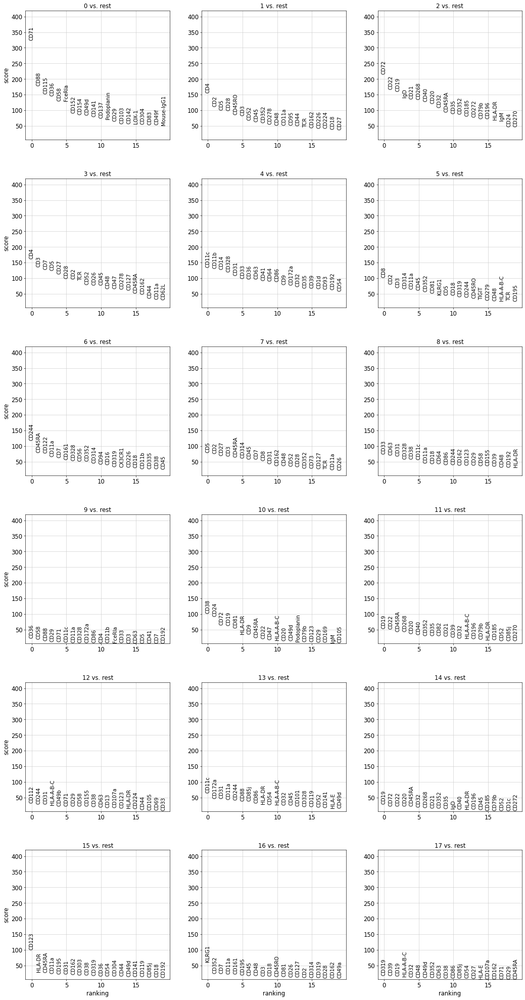

In [50]:
sc.pl.rank_genes_groups(adata_adt, key='rank_'+orig_res, ncols=3, fontsize=12)

## Plot literature markers

In [61]:
from matplotlib import colors

In [62]:
#Define a nice colour map for gene expression
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,3))
colorsComb = np.vstack([colors3, colors2])
mymap_red = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

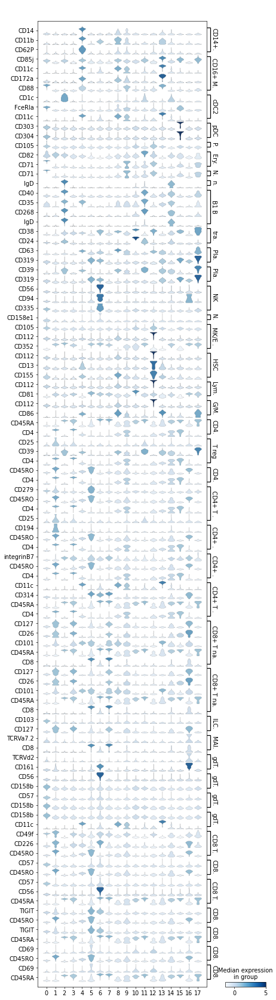

In [63]:
# Look at the marker genes in a concise manner
filt_marker_prots = dict()
for key,val in marker_prots.items():
    filt_vals = [i for i in val if i in adata_adt.var_names]
    filt_marker_prots[key] = filt_vals

adata_plot = adata_adt.copy()
sc.pp.scale(adata_plot, max_value=5)
    
sc.pl.stacked_violin(adata_plot, var_names = filt_marker_prots, groupby=orig_res, use_raw=False, swap_axes=True)

Cluster: Erythro linage


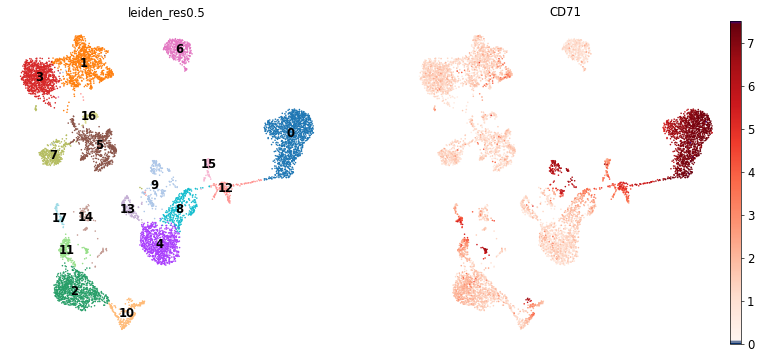

Cluster: CD4+ T


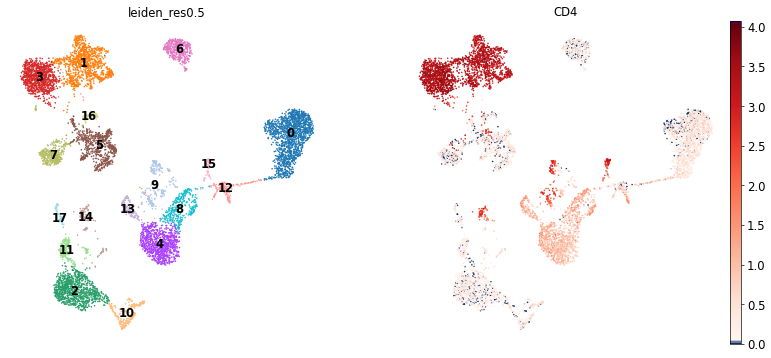

Cluster: CD8+ T


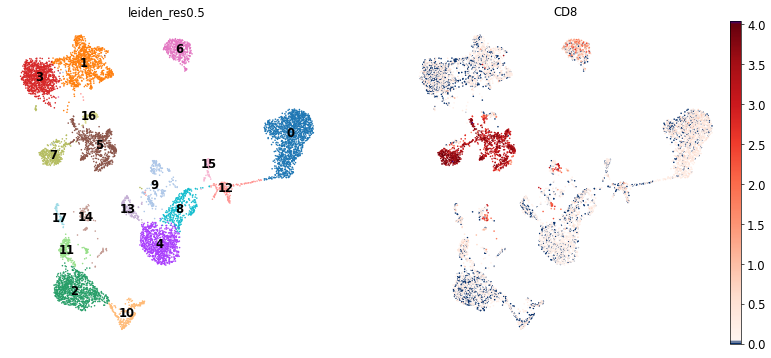

Cluster: B


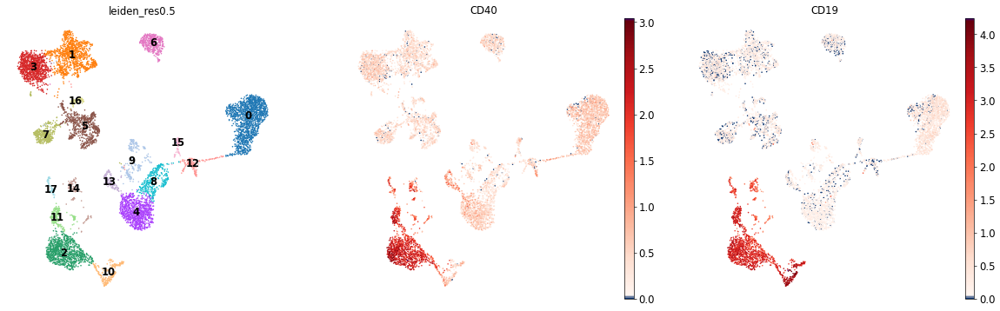

Cluster: Mono


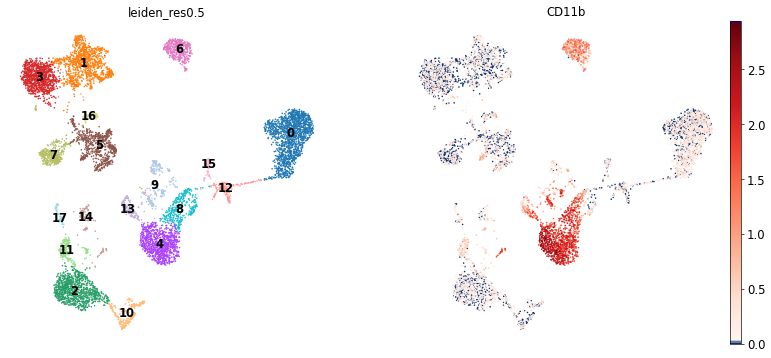

Cluster: Progen


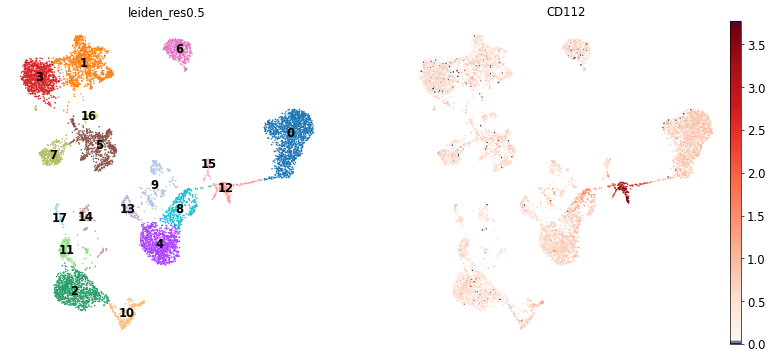

In [64]:
# Look at expression of all proteins
# Note that some markers are meant to be negative! (IgD for B1 B, CD25 for CD4+ T activated instead of Treg, 'CD22', 'CD62P' for HSCs)
for i in high_level_markers.keys():
    print(f'Cluster: {i}')
    genes_to_plot = [i for i in high_level_markers[i] if i in adata_adt.var_names]
    sc.pl.umap(adata_adt, color=[orig_res]+genes_to_plot, ncols=3, use_raw=False, cmap=mymap, legend_loc='on data')

Cluster: CD14+ Mono


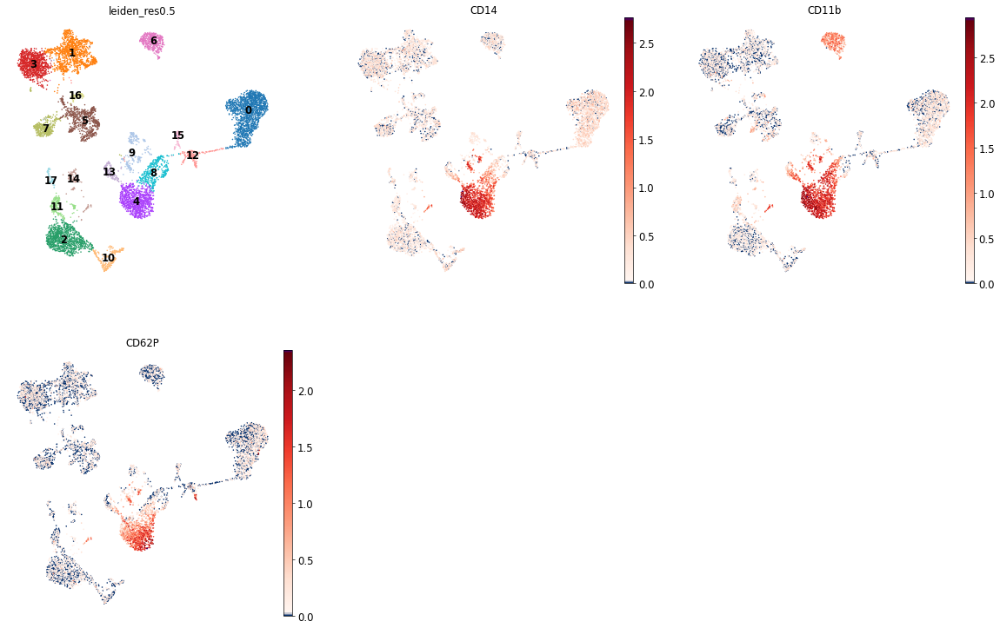

Cluster: CD16+ Mono


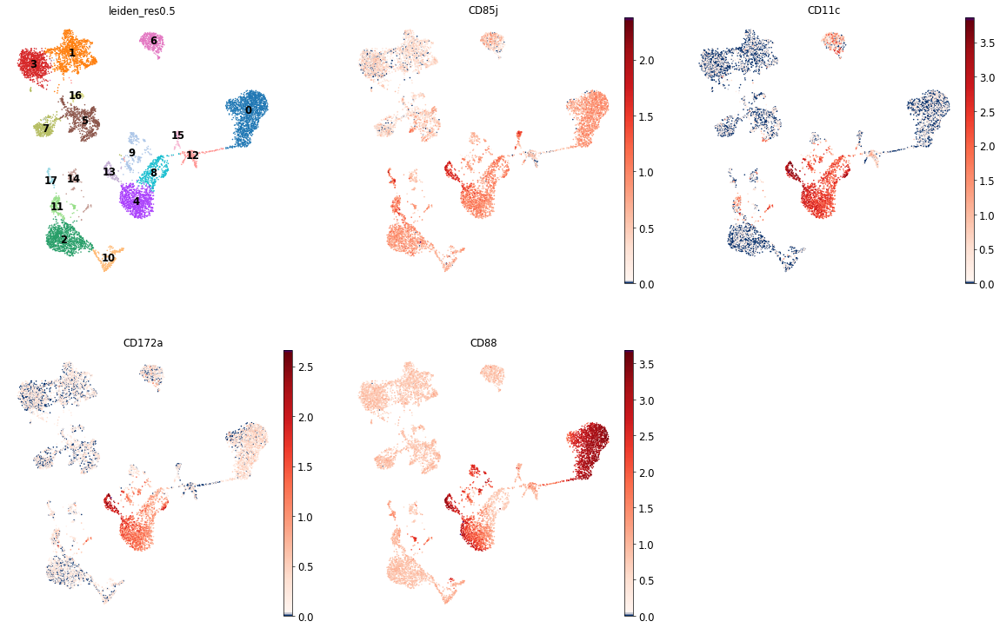

Cluster: cDC2


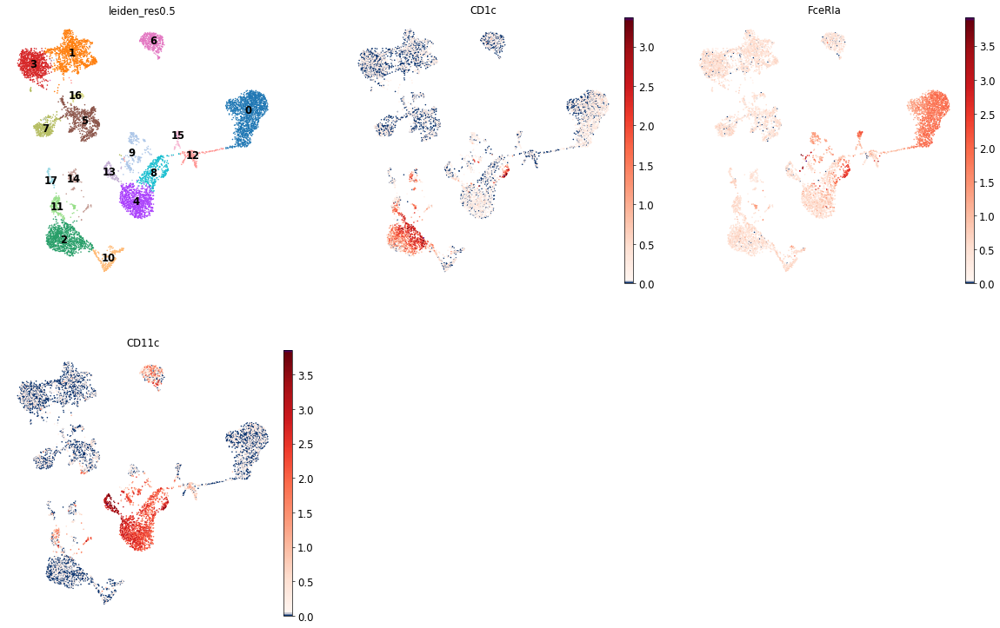

Cluster: pDC


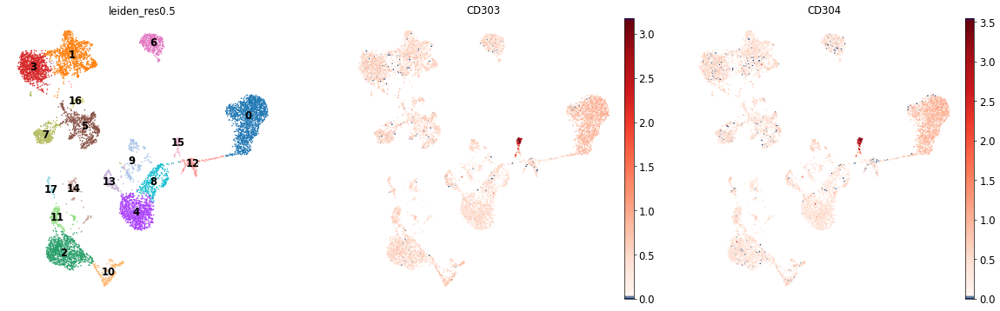

Cluster: Proerythroblast


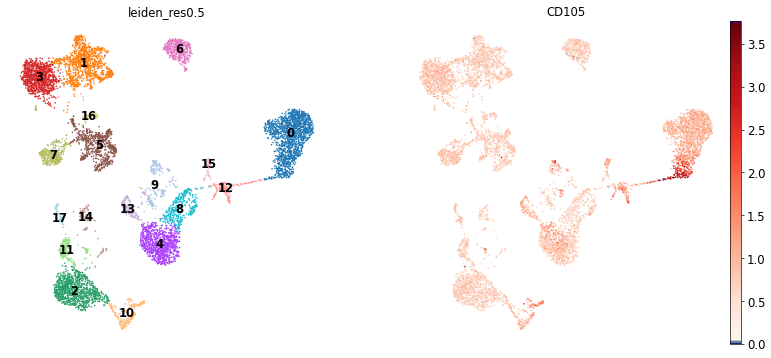

Cluster: Erythroblast


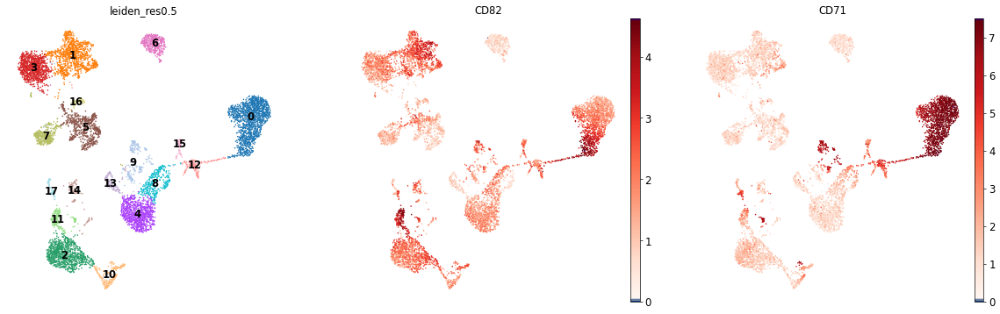

Cluster: Normoblast/Reticulocyte


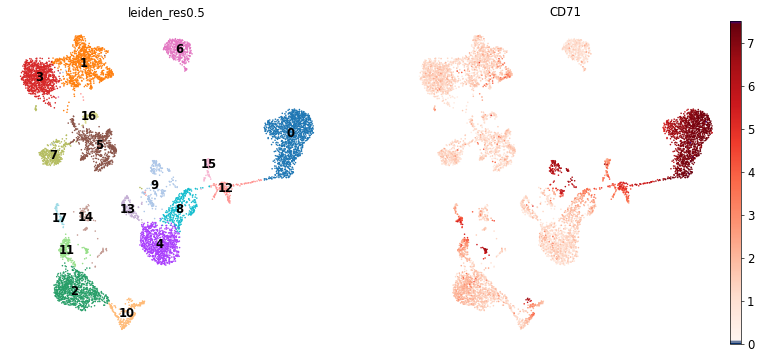

Cluster: naive CD20+ B


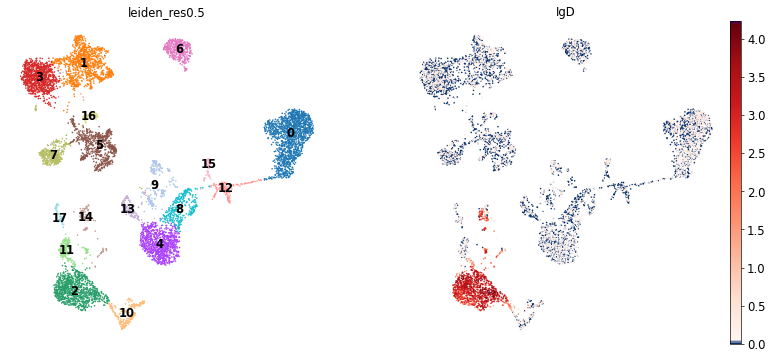

Cluster: B1 B


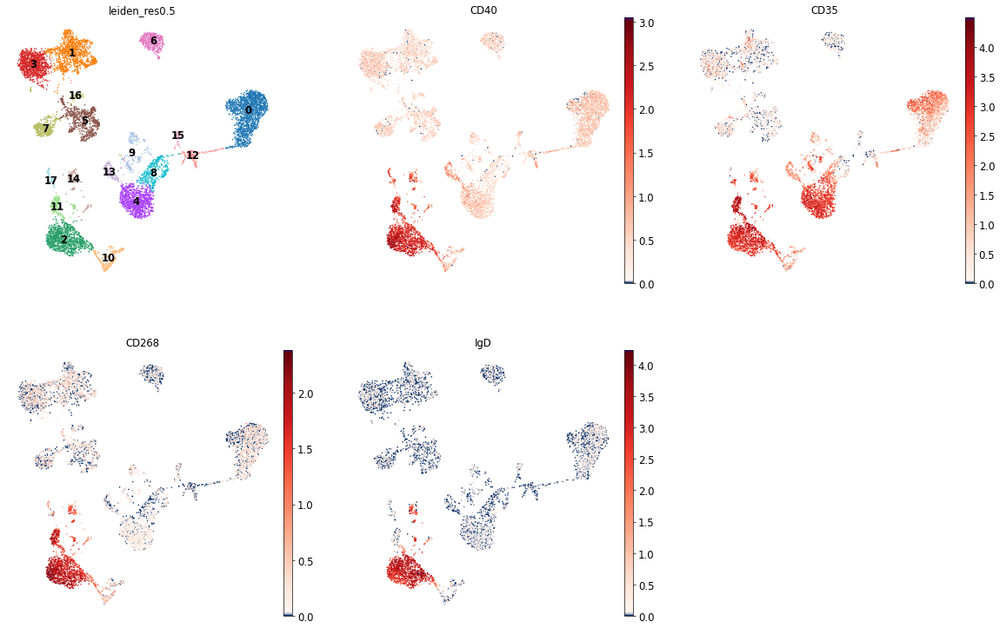

Cluster: transitional B


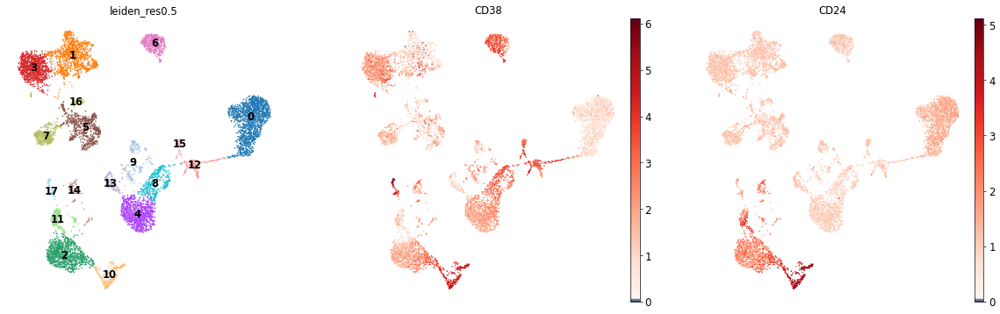

Cluster: Plasma cell


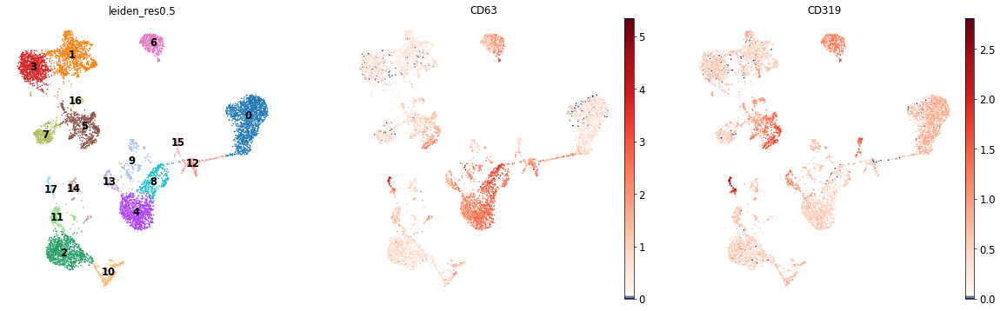

Cluster: Plasmablast


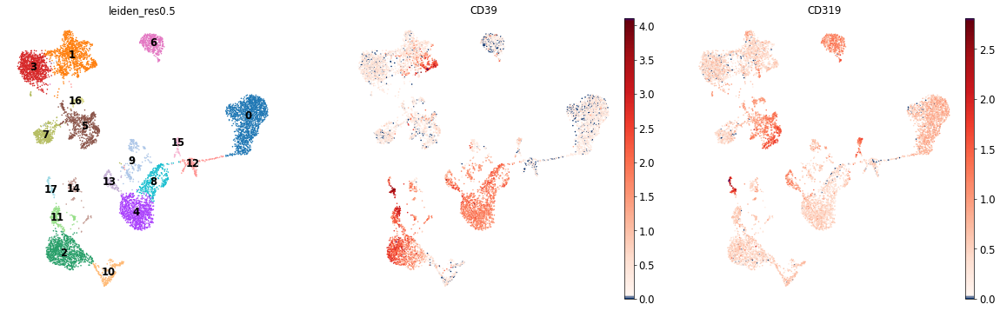

Cluster: NK


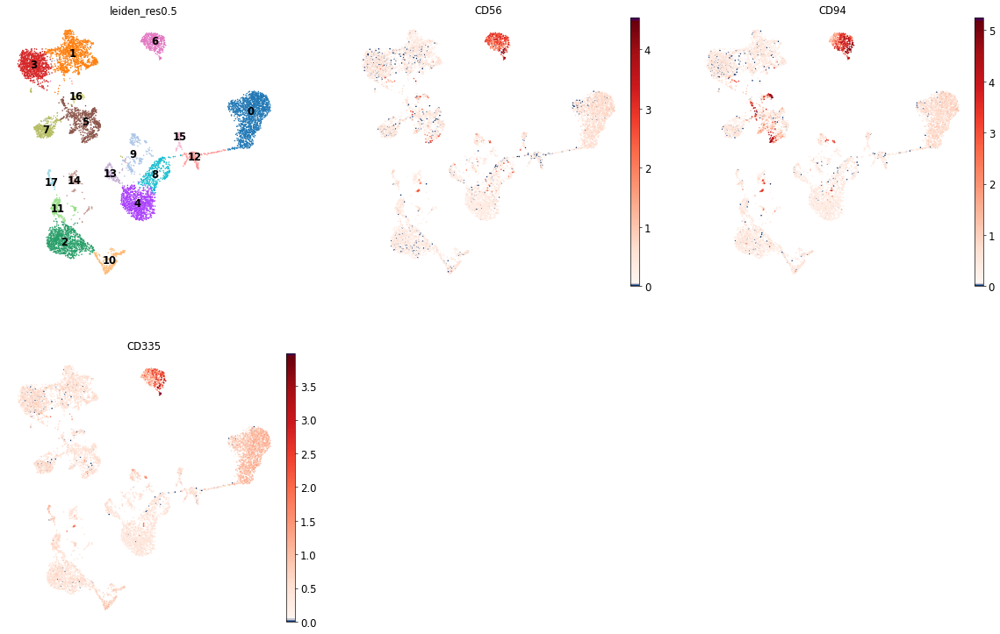

Cluster: NK CD158e1+


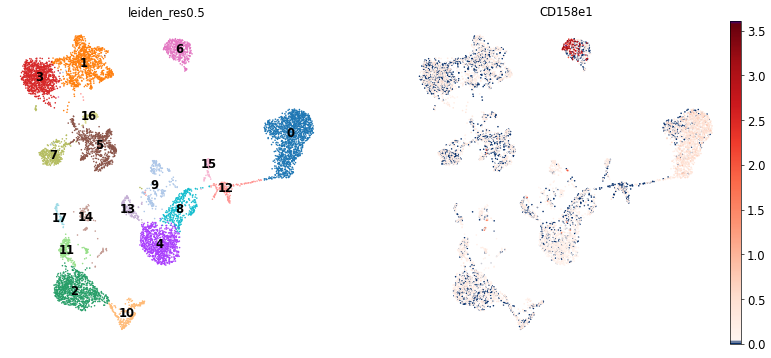

Cluster: MK/E prog


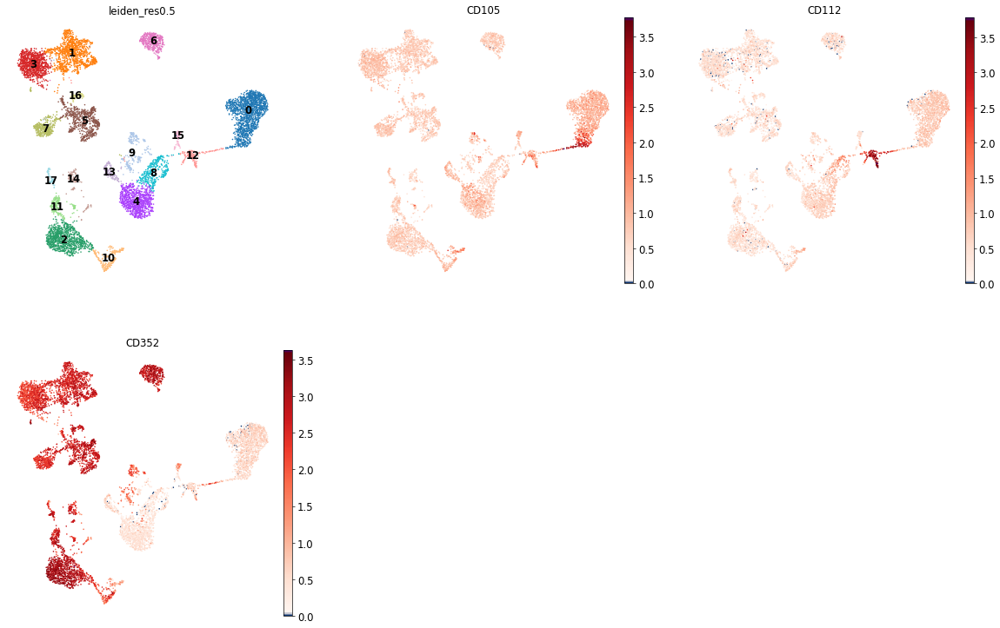

Cluster: HSC


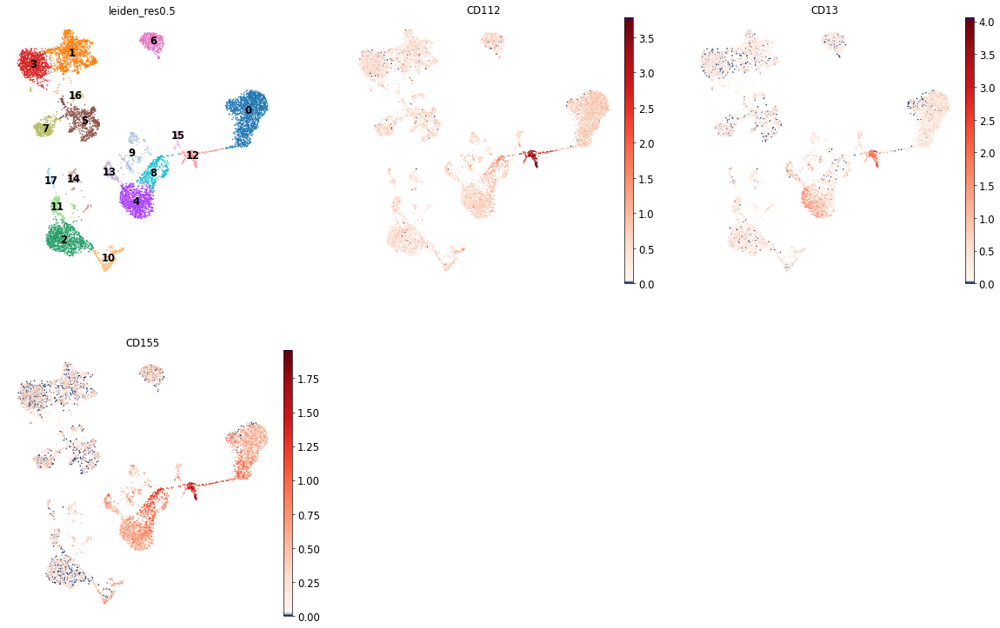

Cluster: Lymph prog


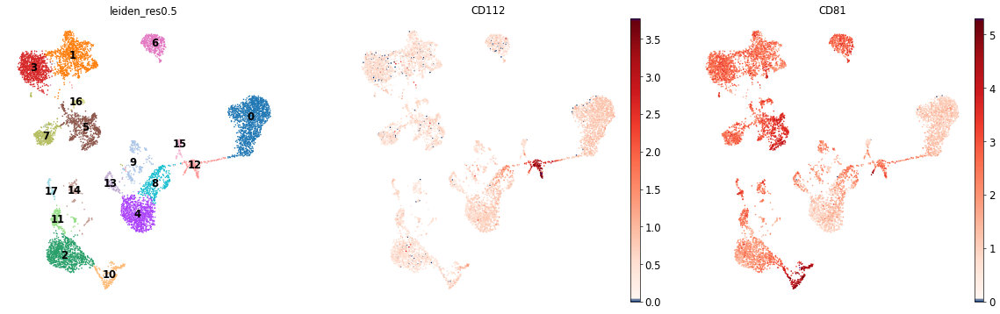

Cluster: G/M prog


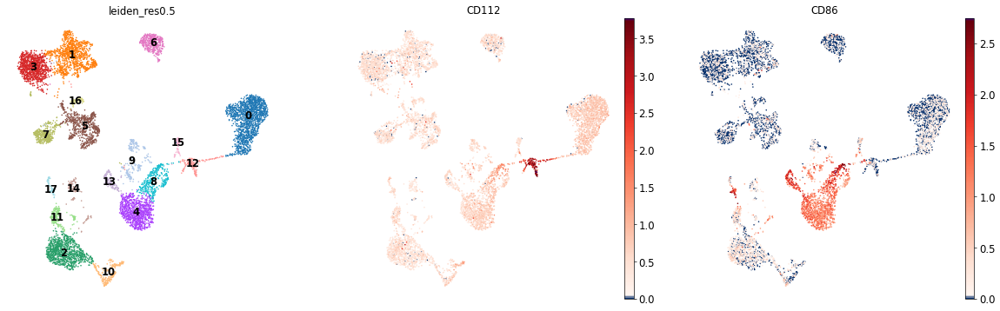

Cluster: CD4+ T naive


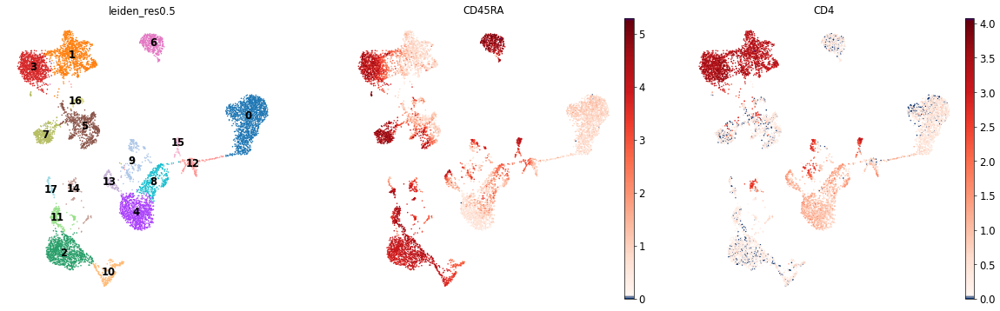

Cluster: T reg


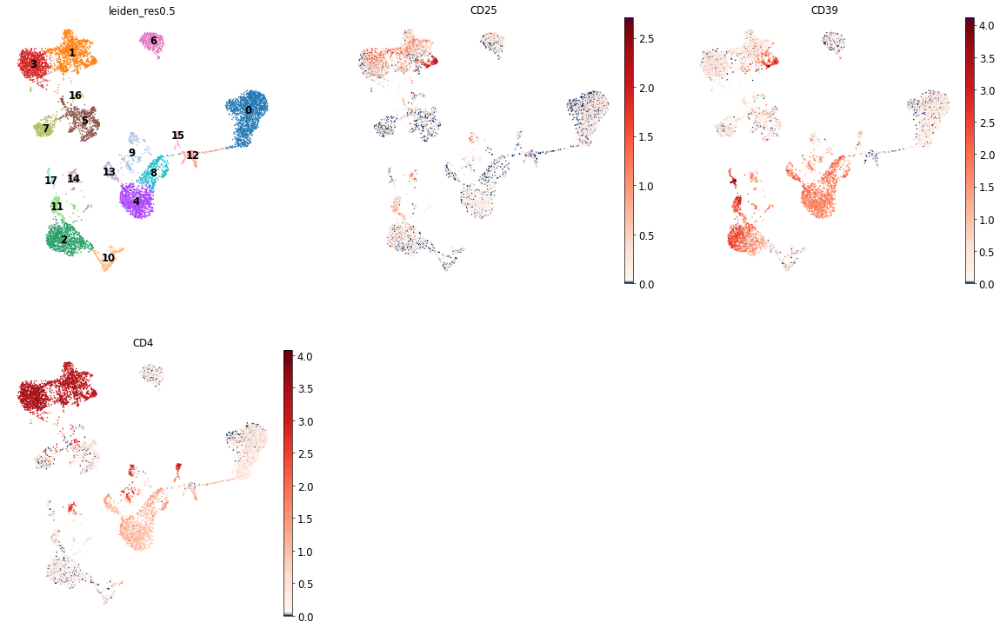

Cluster: CD4+ T activated


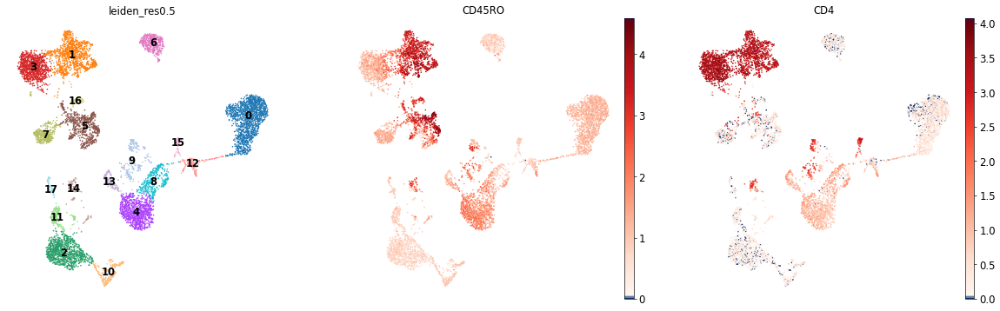

Cluster: CD4+ T activated CD279+


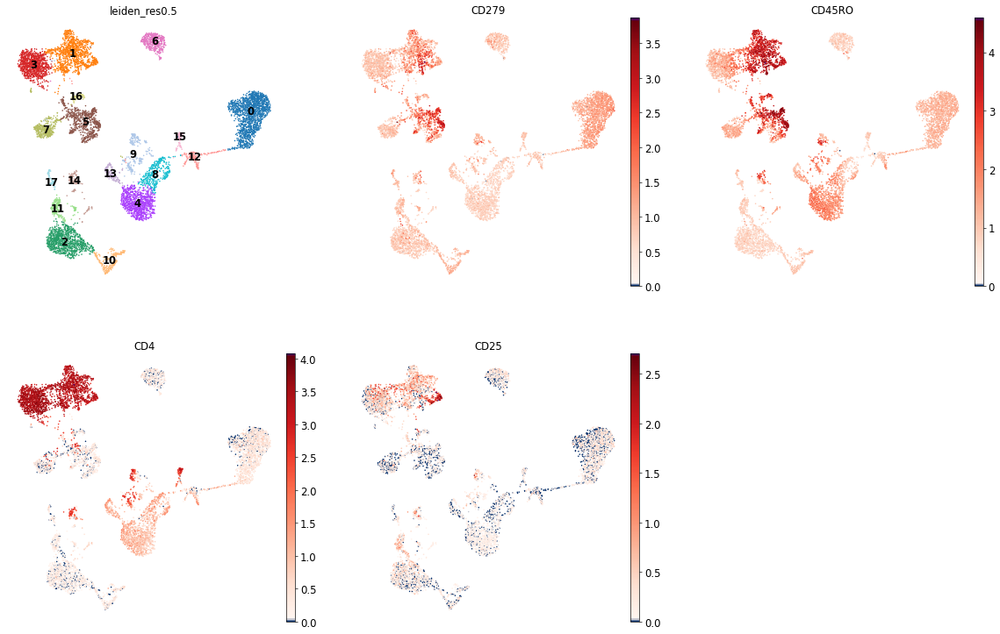

Cluster: CD4+ T activated CD194+


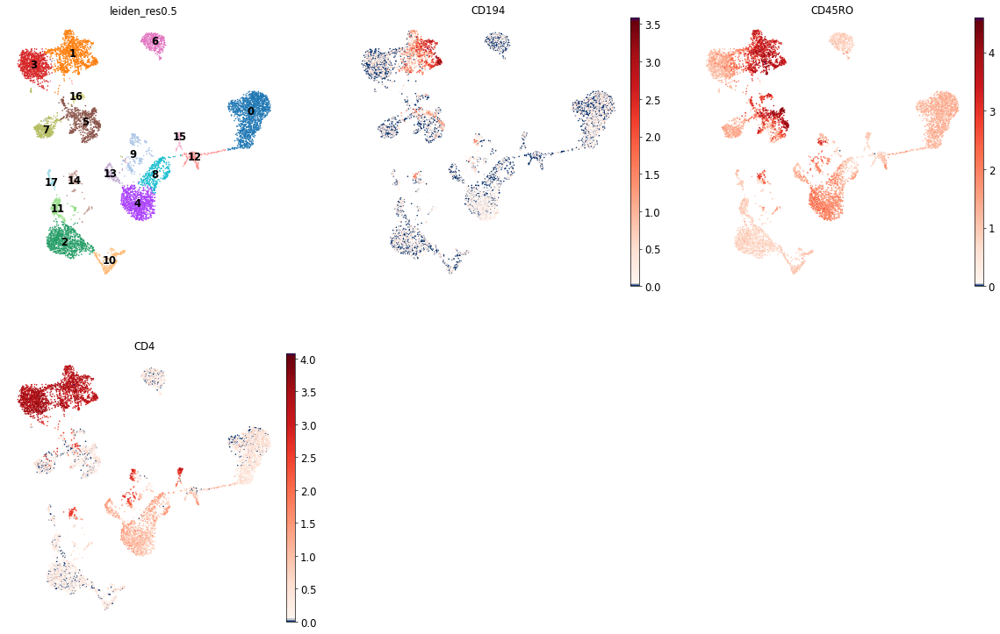

Cluster: CD4+ T activated integrinB7+


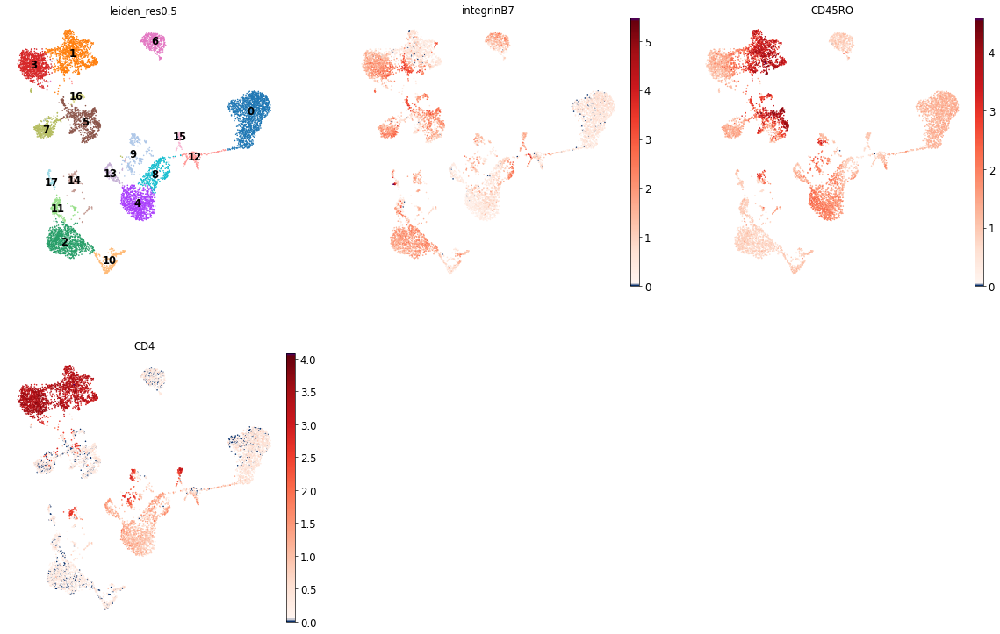

Cluster: CD4+ T CD314+ CD45RA+


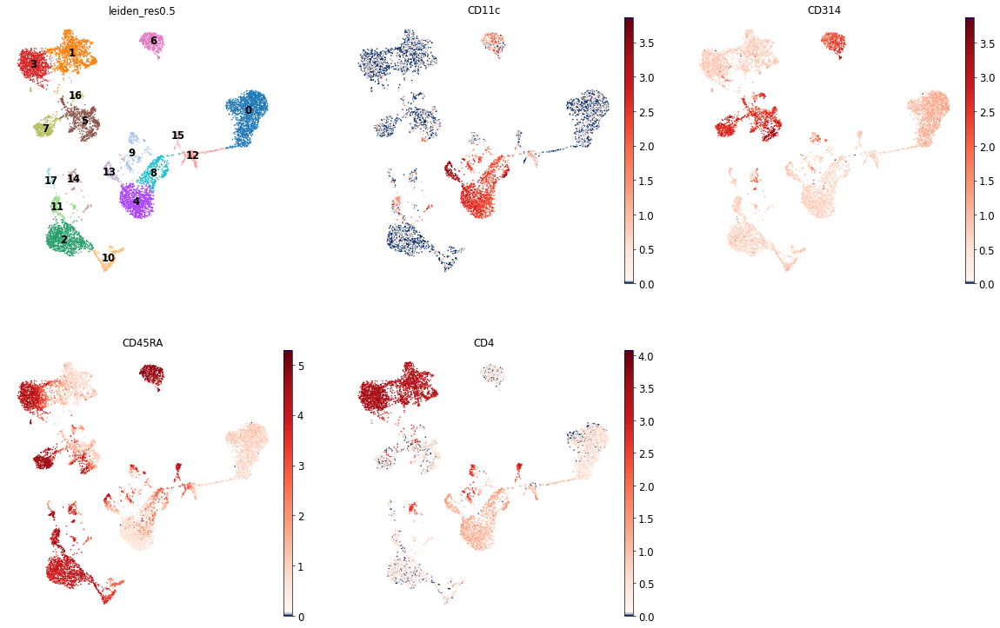

Cluster: CD8+ T naive CD127+ CD26+ CD101+


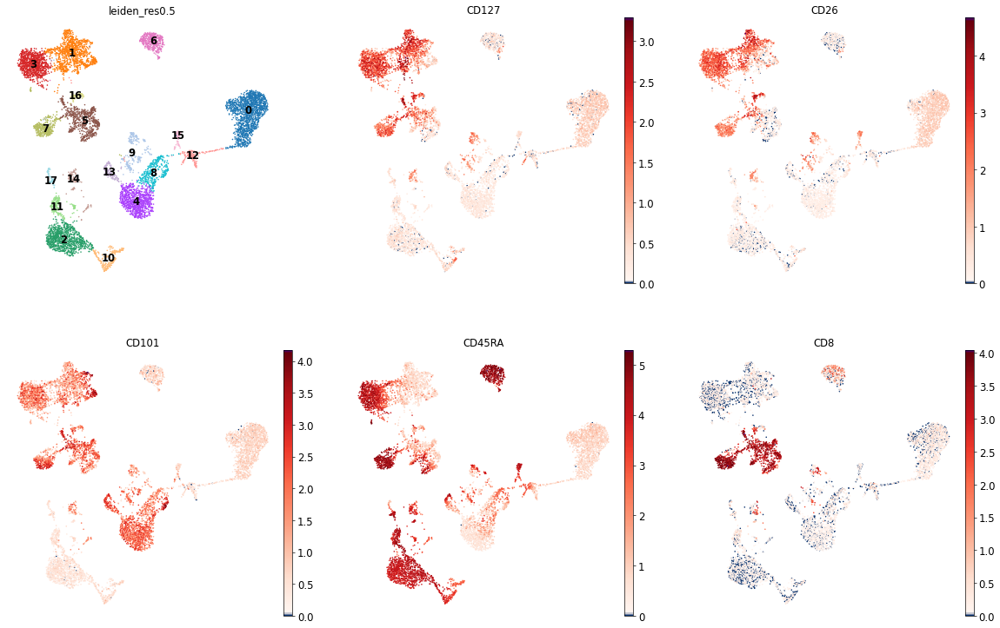

Cluster: CD8+ T naive CD127+ CD26- CD101-


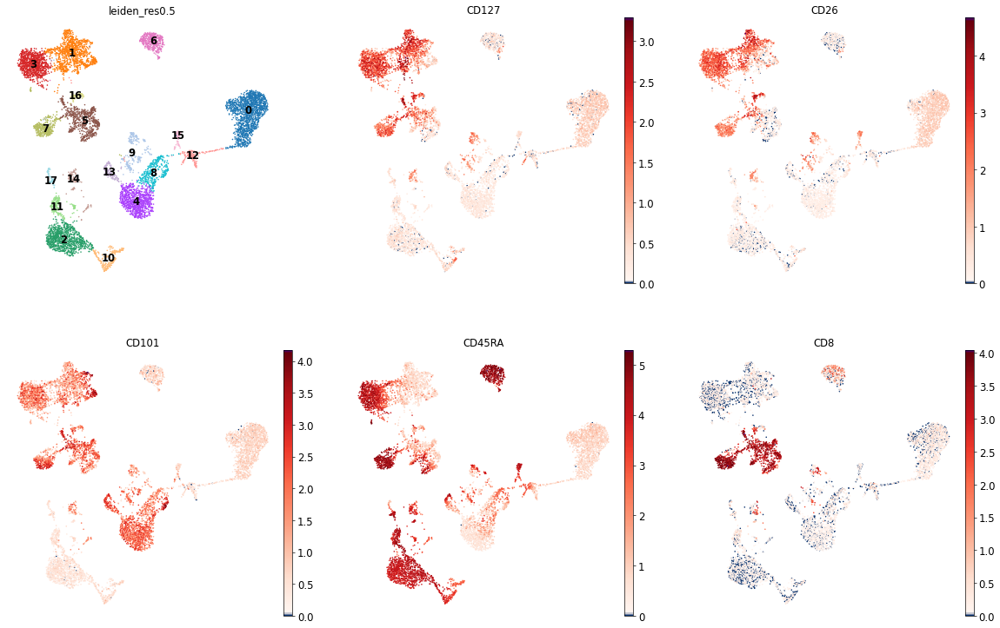

Cluster: ILC1


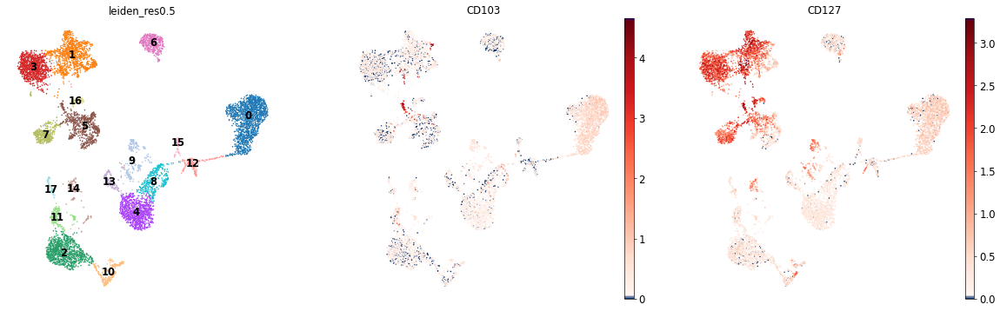

Cluster: MAIT


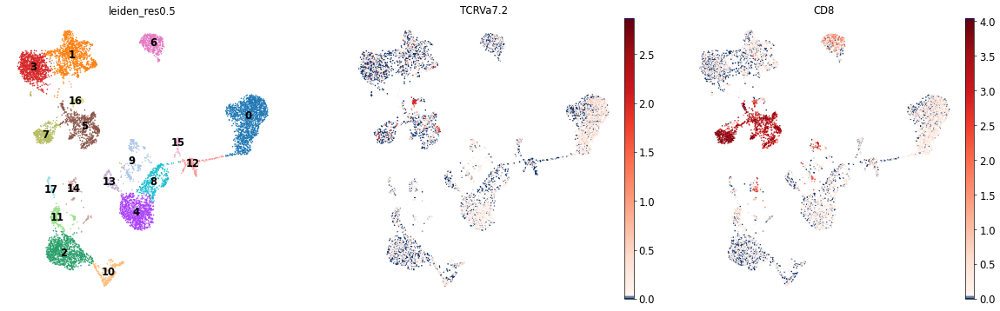

Cluster: gdT TCRVD2+


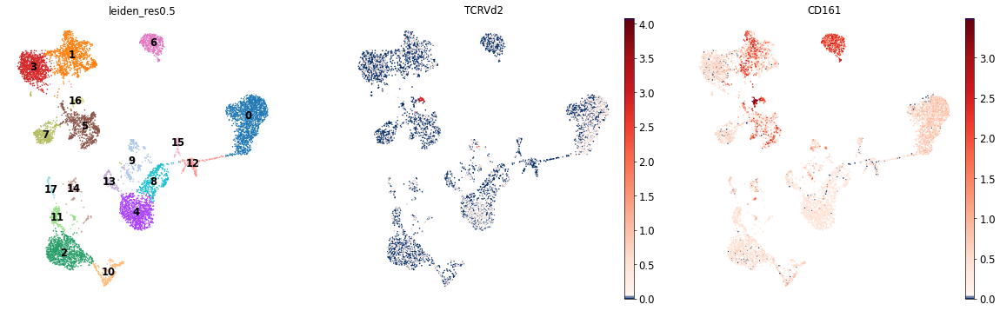

Cluster: gdT CD56+


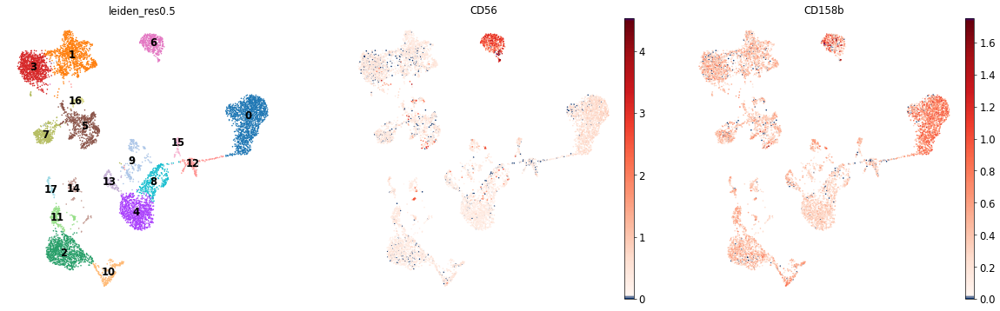

Cluster: gdT Vd1 CD57+


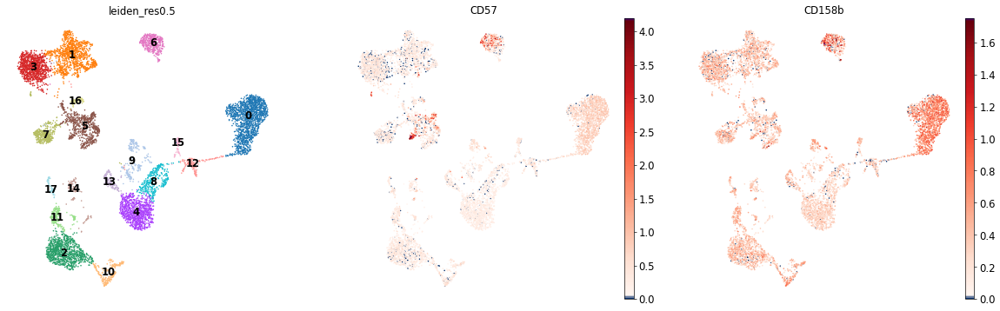

Cluster: gdT CD158b+ CD11c+


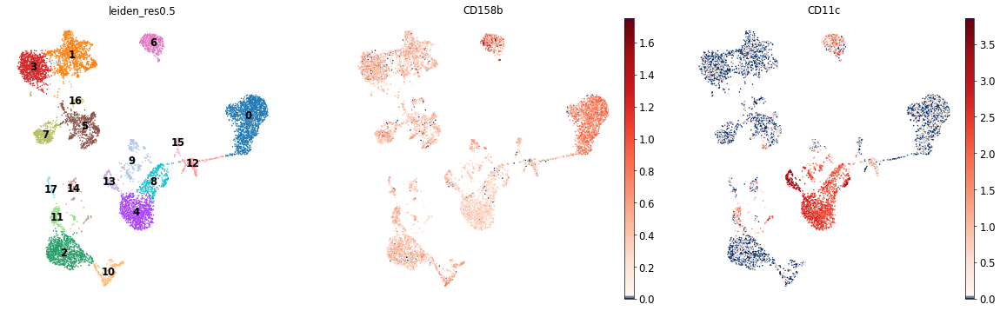

Cluster: CD8 T CD49f+


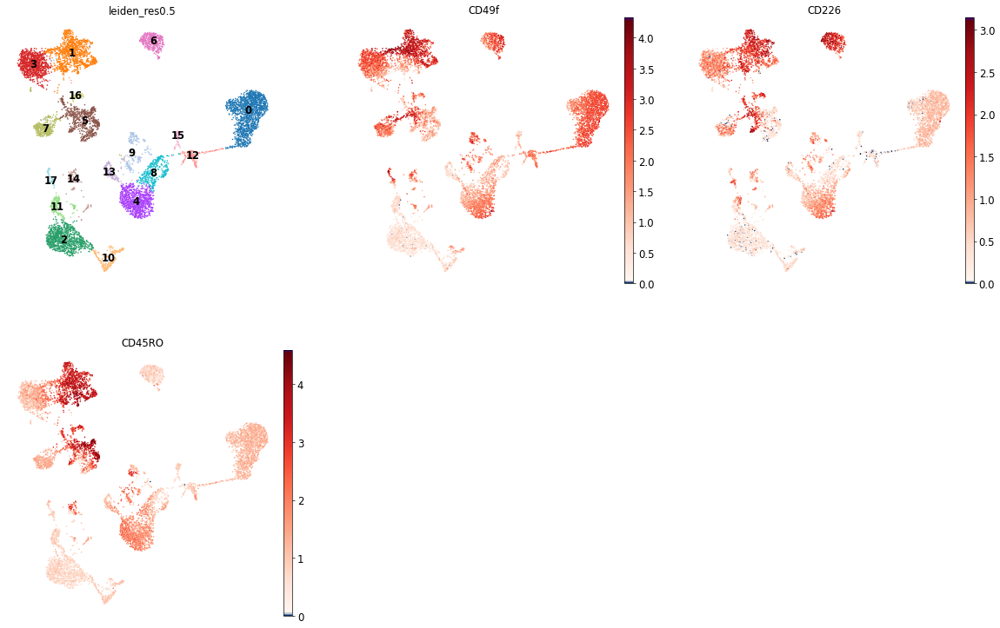

Cluster: CD8 T CD57+ CD45RO+


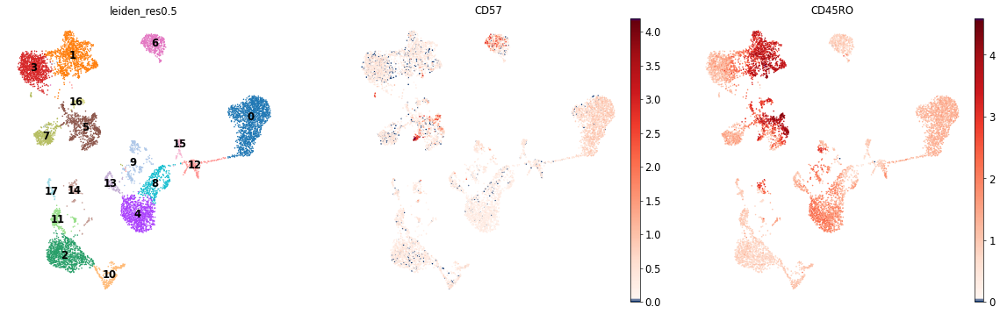

Cluster: CD8 T CD57+ CD45RA+


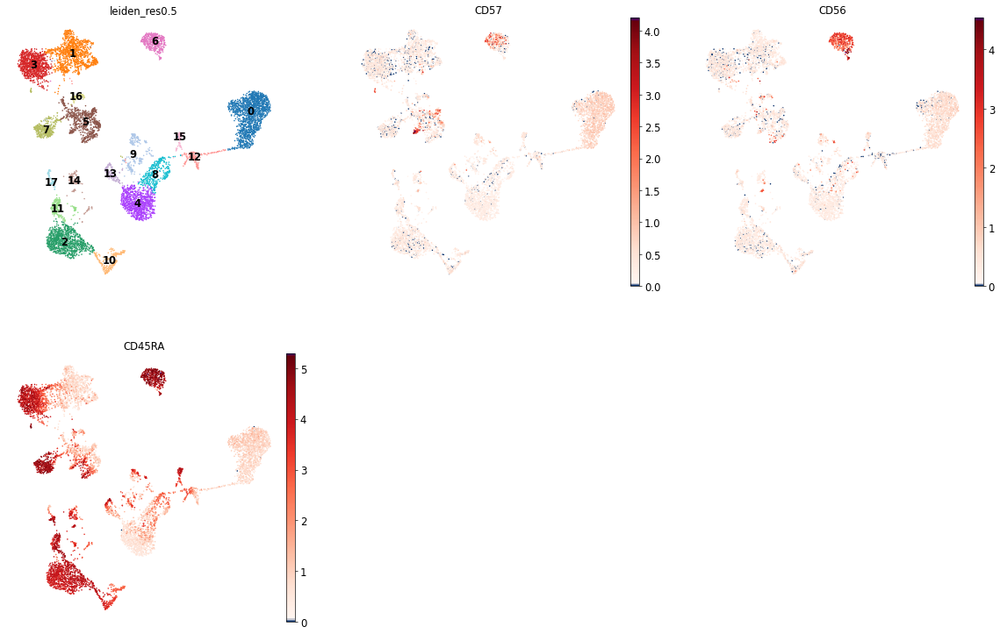

Cluster: CD8 T TIGIT+ CD45RO+


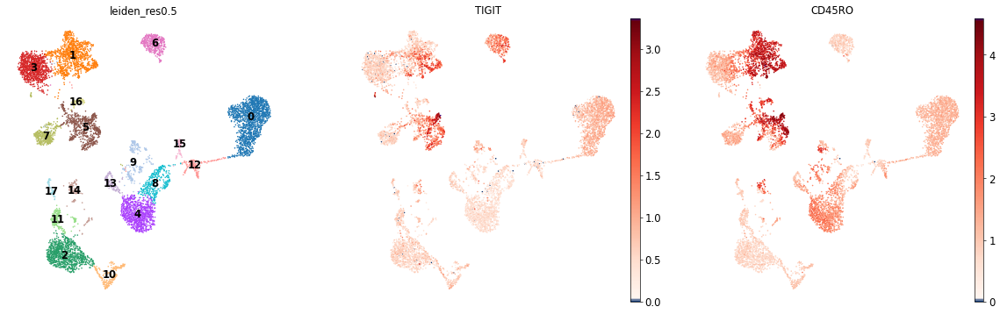

Cluster: CD8 T TIGIT+ CD45RA+


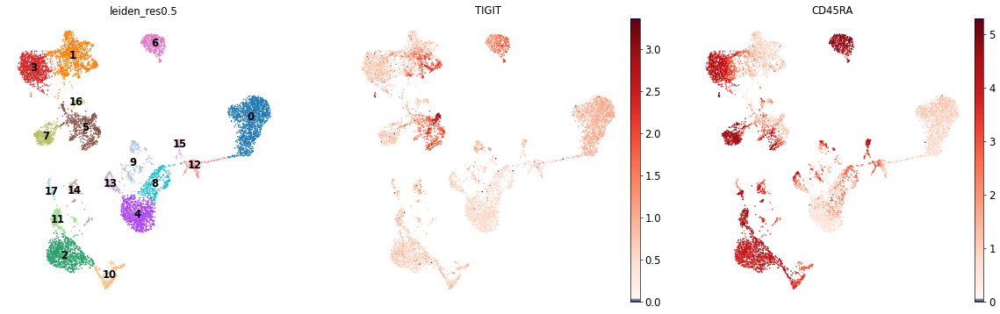

Cluster: CD8 T CD69+ CD45RO+


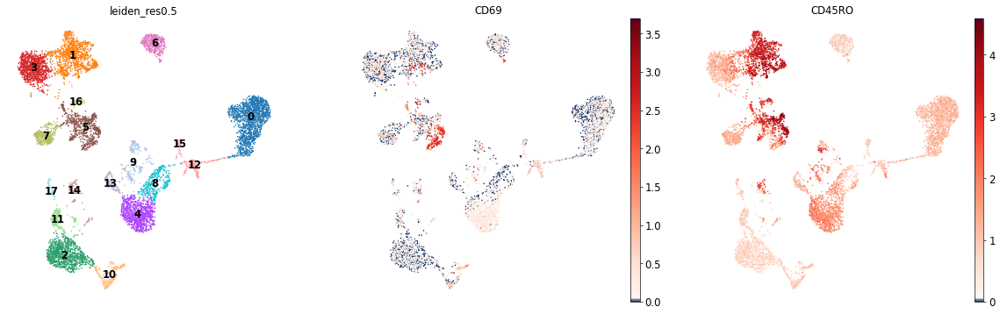

Cluster: CD8 T CD69+ CD45RA+


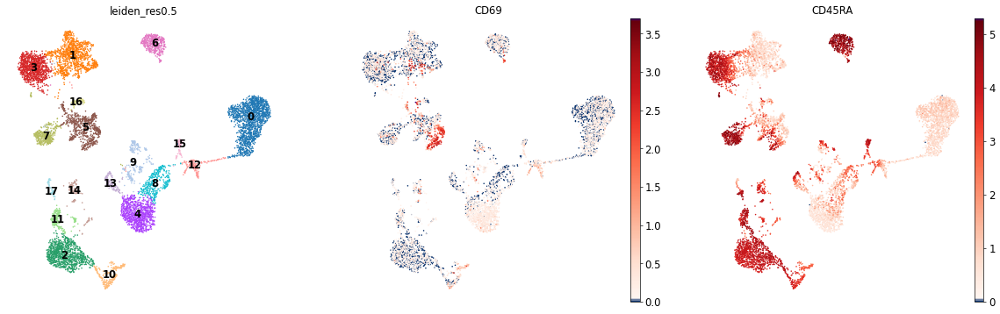

In [65]:
# Look at expression of all proteins
# Note that some markers are meant to be negative! (IgD for B1 B, CD25 for CD4+ T activated instead of Treg, 'CD22', 'CD62P' for HSCs)
for i in marker_prots.keys():
    print(f'Cluster: {i}')
    genes_to_plot = [i for i in marker_prots[i] if i in adata_adt.var_names]
    sc.pl.umap(adata_adt, color=[orig_res]+genes_to_plot, ncols=3, use_raw=False, cmap=mymap, legend_loc='on data')

In [66]:
# Look at expression of all proteins
# Note that some markers are meant to be negative! (DMXL2, HBM, GYPA, IGHD, IGHM for some cell types)

#for i in adata_adt.var_names:
#    print(f'Cluster: {i}')
#    if i in adata_adt.var_names:
#        sc.pl.umap(adata_adt, color=i, ncols=3, use_raw=False, cmap=mymap_red)
        


In [67]:
initial_cluster_dict={
    
    '0':'Proerythroblast - Erythroblast - Normoblast/Reticulocyte',
    '1':'CD4+ T activated - Tregs',
    '2':'Naive CD20+ B',
    '3':'CD4+ T naive',
    '4':'CD14+ Mono',
    '5':'CD8+ T activated TIGIT+ - CD8+ T activated CD69+ - Lymph prog',
    '6':'NK',
    '7':'CD8+ T naive',
    '8':'cDC2 and probably doublet',
    '9':'doublet',
    '10':'Transitional B',
    '11':'B1 B',
    '12':'HSC',
    '13':'CD16+ Mono',
    '14':'doublet',
    '15':'pDCs',
    '16':'gdT - NKT',
    '17':'Plasmablast - Plasma cells',
    
}

In [68]:
adata_adt

AnnData object with n_obs × n_vars = 8455 × 140
    obs: 'n_antibodies_by_counts', 'log1p_n_antibodies_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_5_antibodies', 'pct_counts_in_top_10_antibodies', 'iso_count', 'iso_count_col', 'log_iso_count', 'iso_count_fltr', 'n_counts', 'leiden', 'leiden_res0.3', 'leiden_res0.5', 'leiden_res0.8', 'leiden_res1', 'doublet_score', 'predicted_doublet'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'iso_count_fltr_colors', 'pca', 'neighbors', 'leiden', 'umap', 'leiden_res0.3_colors', 'leiden_res0.5_colors', 'leiden_res0.8_colors', 'leiden_res1_colors', 'predicted_doublet_colors', 'rank_leiden_res0.5'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

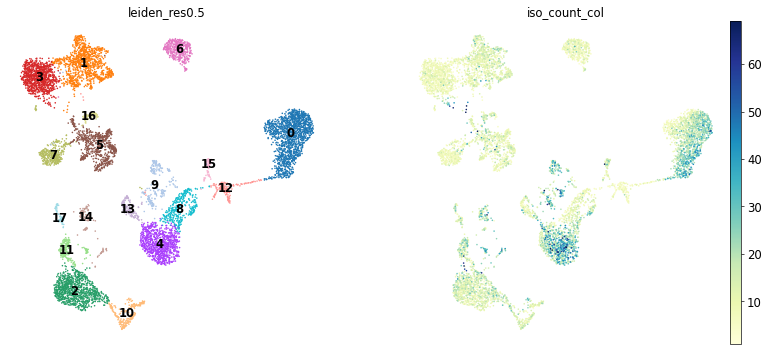

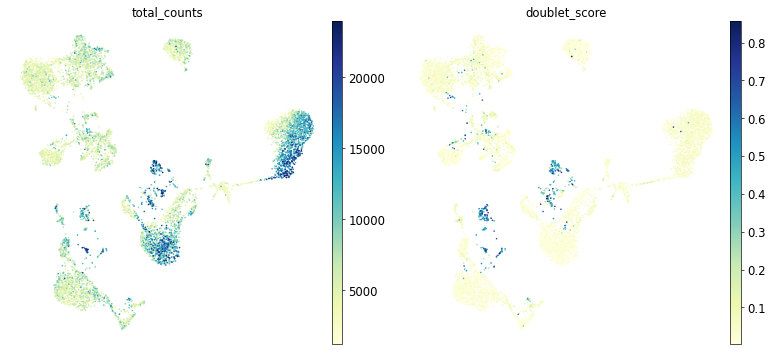

In [69]:
# Check some technical markers to assess potential doublet or low quality clusters
sc.pl.umap(adata_adt, color=[orig_res, 'iso_count_col'], legend_loc='on data')
sc.pl.umap(adata_adt, color=['total_counts', 'doublet_score'])

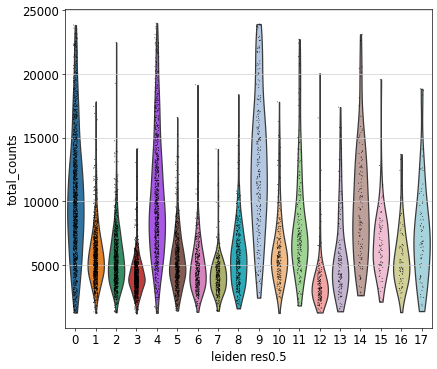

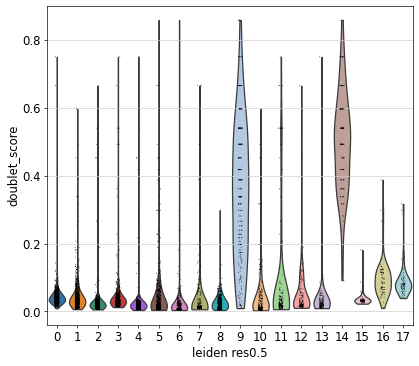

In [70]:
sc.pl.violin(adata_adt, keys='total_counts', groupby=orig_res)
sc.pl.violin(adata_adt, keys='doublet_score', groupby=orig_res)

Clusters 9 and 14 are likely doublets

# Subclustering

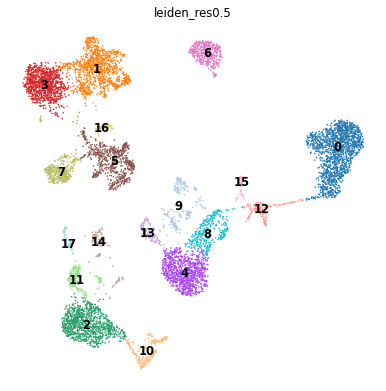

In [299]:
sc.pl.umap(adata_adt, color=orig_res, legend_loc='on data')

## Erythroid lineage

### Cluster 0 

In [300]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDC', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'naive CD20+ B', 'B1 B', 'transitional B', 'Plasma cell', 'Plasmablast', 'NK', 'NK CD158e1+', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog', 'CD4+ T naive', 'T reg', 'CD4+ T activated', 'CD4+ T activated CD279+', 'CD4+ T activated CD194+', 'CD4+ T activated integrinB7+', 'CD4+ T CD314+ CD45RA+', 'CD8+ T naive CD127+ CD26+ CD101+', 'CD8+ T naive CD127+ CD26- CD101-', 'ILC1', 'MAIT', 'gdT TCRVD2+', 'gdT CD56+', 'gdT Vd1 CD57+', 'gdT CD158b+ CD11c+', 'CD8 T CD49f+', 'CD8 T CD57+ CD45RO+', 'CD8 T CD57+ CD45RA+', 'CD8 T TIGIT+ CD45RO+', 'CD8 T TIGIT+ CD45RA+', 'CD8 T CD69+ CD45RO+', 'CD8 T CD69+ CD45RA+'])

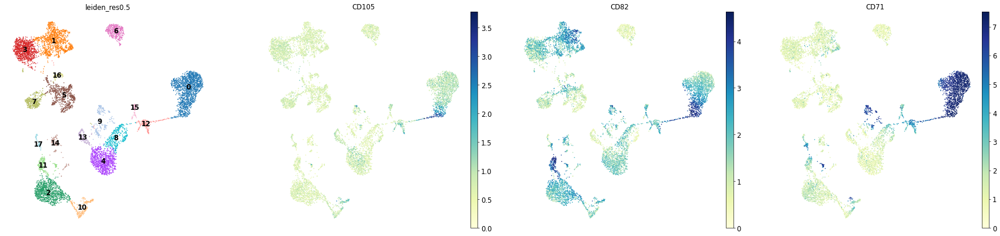

In [301]:
m_genes1 = marker_prots['Proerythroblast']
m_genes2 = marker_prots['Erythroblast']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1+m_genes2, legend_loc = 'on data')

In [302]:
orig_key = orig_res # only for first subclustering to generate new column
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '0'

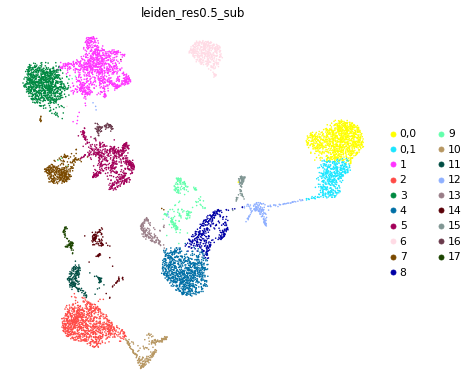

1      1061
0,0     990
2       967
3       966
4       860
5       692
0,1     458
6       418
7       369
8       360
9       235
10      229
11      192
12      166
13      140
14      130
15       79
16       74
17       69
Name: leiden_res0.5_sub, dtype: int64

In [303]:
res = 0.2
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key)
adata_adt.obs[new_key].value_counts()

In [304]:
orig_key = 'leiden_res0.5_sub' 
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '0,1'

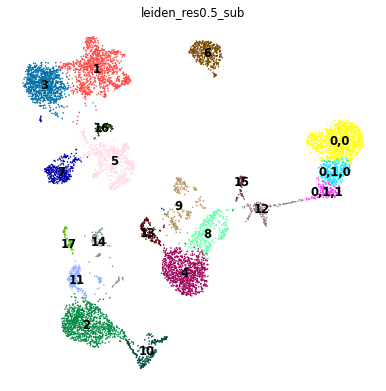

1        1061
0,0       990
2         967
3         966
4         860
5         692
6         418
7         369
8         360
0,1,0     317
9         235
10        229
11        192
12        166
0,1,1     141
13        140
14        130
15         79
16         74
17         69
Name: leiden_res0.5_sub, dtype: int64

In [305]:
res = 0.2
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key, legend_loc = 'on data')
adata_adt.obs[new_key].value_counts()

### Summary

- Overlapping erythrocyte stages

In [306]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDC', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'naive CD20+ B', 'B1 B', 'transitional B', 'Plasma cell', 'Plasmablast', 'NK', 'NK CD158e1+', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog', 'CD4+ T naive', 'T reg', 'CD4+ T activated', 'CD4+ T activated CD279+', 'CD4+ T activated CD194+', 'CD4+ T activated integrinB7+', 'CD4+ T CD314+ CD45RA+', 'CD8+ T naive CD127+ CD26+ CD101+', 'CD8+ T naive CD127+ CD26- CD101-', 'ILC1', 'MAIT', 'gdT TCRVD2+', 'gdT CD56+', 'gdT Vd1 CD57+', 'gdT CD158b+ CD11c+', 'CD8 T CD49f+', 'CD8 T CD57+ CD45RO+', 'CD8 T CD57+ CD45RA+', 'CD8 T TIGIT+ CD45RO+', 'CD8 T TIGIT+ CD45RA+', 'CD8 T CD69+ CD45RO+', 'CD8 T CD69+ CD45RA+'])

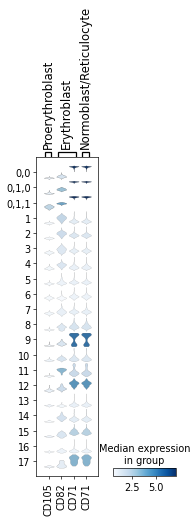

In [307]:
sc.pl.stacked_violin(adata_adt, var_names={a:marker_prots[a] for a in ['Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte']}, groupby=new_key)

## T lineage + NK

### Cluster 1

In [308]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDC', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'naive CD20+ B', 'B1 B', 'transitional B', 'Plasma cell', 'Plasmablast', 'NK', 'NK CD158e1+', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog', 'CD4+ T naive', 'T reg', 'CD4+ T activated', 'CD4+ T activated CD279+', 'CD4+ T activated CD194+', 'CD4+ T activated integrinB7+', 'CD4+ T CD314+ CD45RA+', 'CD8+ T naive CD127+ CD26+ CD101+', 'CD8+ T naive CD127+ CD26- CD101-', 'ILC1', 'MAIT', 'gdT TCRVD2+', 'gdT CD56+', 'gdT Vd1 CD57+', 'gdT CD158b+ CD11c+', 'CD8 T CD49f+', 'CD8 T CD57+ CD45RO+', 'CD8 T CD57+ CD45RA+', 'CD8 T TIGIT+ CD45RO+', 'CD8 T TIGIT+ CD45RA+', 'CD8 T CD69+ CD45RO+', 'CD8 T CD69+ CD45RA+'])

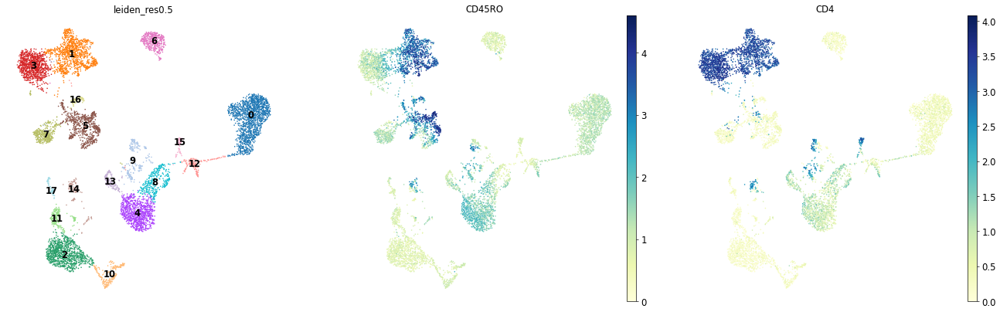

In [309]:
m_genes = marker_prots['CD4+ T activated']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes, legend_loc = 'on data')

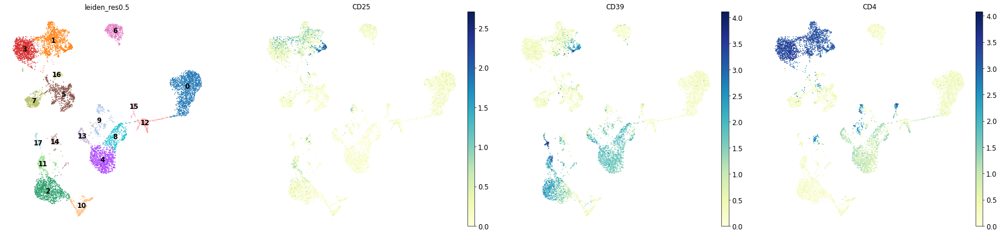

In [310]:
m_genes = marker_prots['T reg']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes, legend_loc = 'on data')

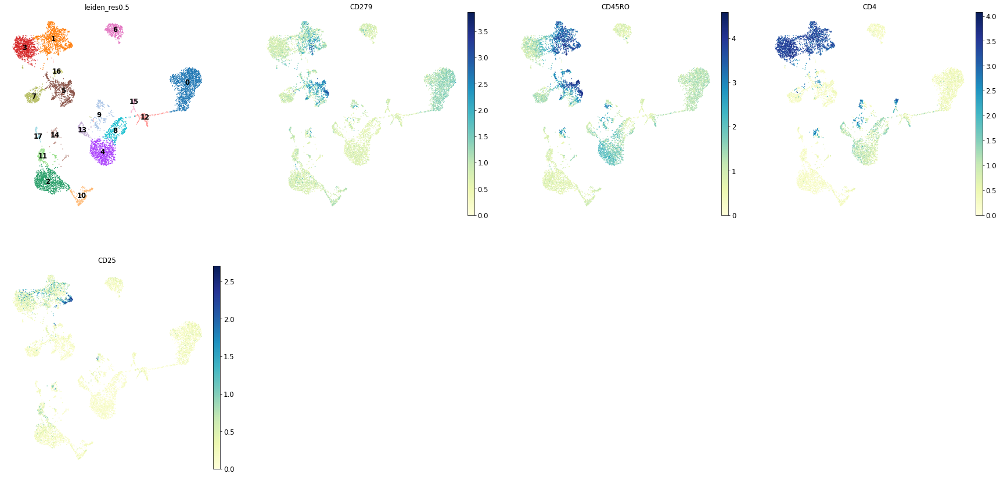

In [311]:
m_genes = marker_prots['CD4+ T activated CD279+']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes, legend_loc = 'on data')

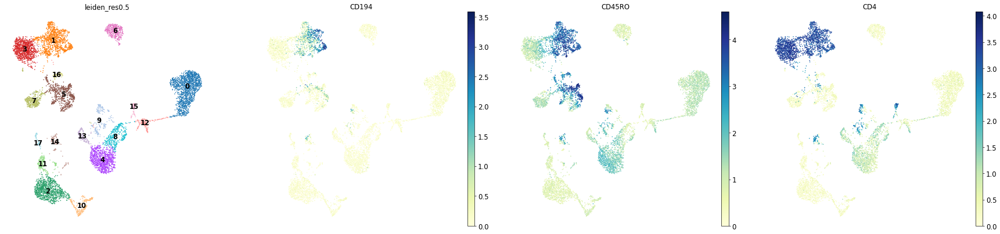

In [312]:
m_genes = marker_prots['CD4+ T activated CD194+']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes, legend_loc = 'on data')

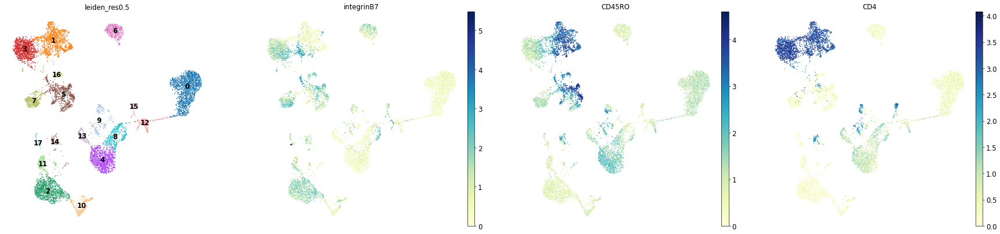

In [313]:
m_genes = marker_prots['CD4+ T activated integrinB7+']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes, legend_loc = 'on data')

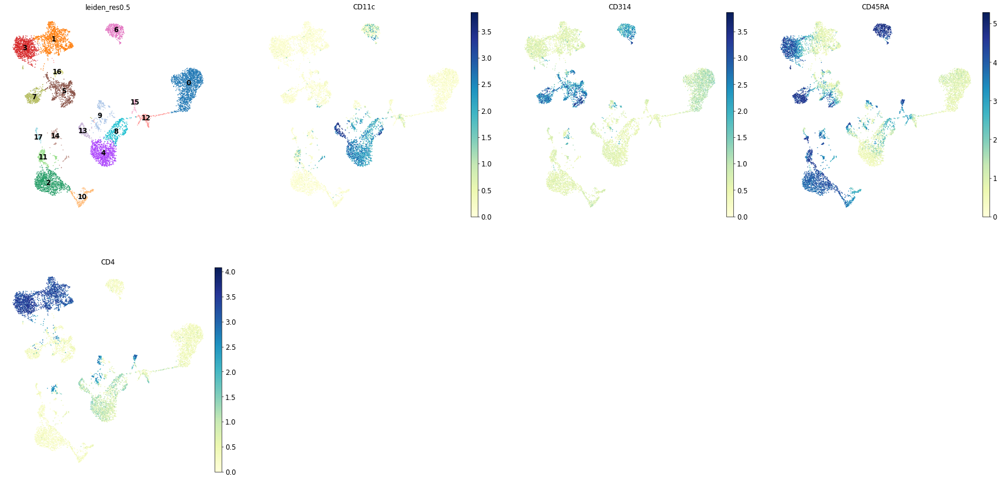

In [314]:
m_genes = marker_prots['CD4+ T CD314+ CD45RA+']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes, legend_loc = 'on data')

In [315]:
orig_key = 'leiden_res0.5_sub' 
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '1'

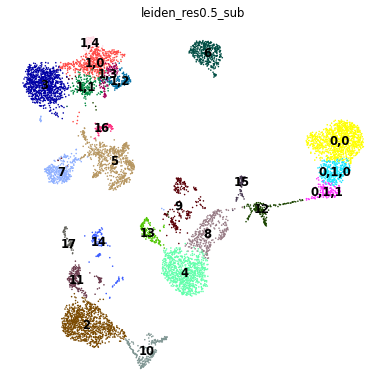

0,0      990
2        967
3        966
4        860
5        692
1,0      528
6        418
7        369
8        360
0,1,0    317
9        235
10       229
1,1      204
11       192
12       166
1,2      150
0,1,1    141
13       140
14       130
1,3       95
1,4       84
15        79
16        74
17        69
Name: leiden_res0.5_sub, dtype: int64

In [316]:
res = 0.35
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key, legend_loc = 'on data')
adata_adt.obs[new_key].value_counts()

### Cluster 3

In [317]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDC', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'naive CD20+ B', 'B1 B', 'transitional B', 'Plasma cell', 'Plasmablast', 'NK', 'NK CD158e1+', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog', 'CD4+ T naive', 'T reg', 'CD4+ T activated', 'CD4+ T activated CD279+', 'CD4+ T activated CD194+', 'CD4+ T activated integrinB7+', 'CD4+ T CD314+ CD45RA+', 'CD8+ T naive CD127+ CD26+ CD101+', 'CD8+ T naive CD127+ CD26- CD101-', 'ILC1', 'MAIT', 'gdT TCRVD2+', 'gdT CD56+', 'gdT Vd1 CD57+', 'gdT CD158b+ CD11c+', 'CD8 T CD49f+', 'CD8 T CD57+ CD45RO+', 'CD8 T CD57+ CD45RA+', 'CD8 T TIGIT+ CD45RO+', 'CD8 T TIGIT+ CD45RA+', 'CD8 T CD69+ CD45RO+', 'CD8 T CD69+ CD45RA+'])

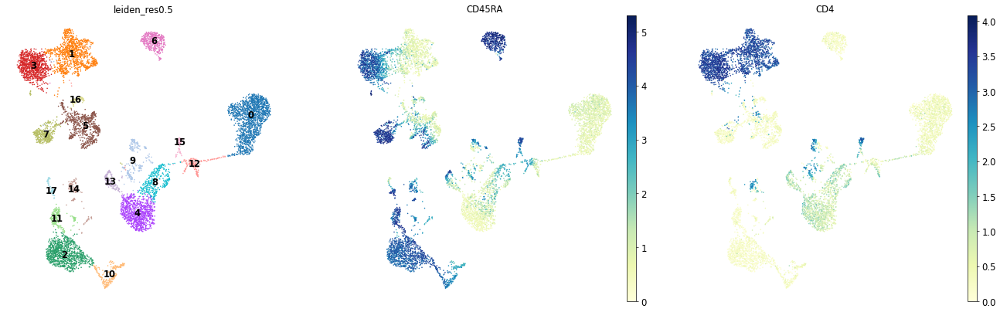

In [318]:
#m_genes1 = marker_prots['CD4+ T activated']
m_genes2 = marker_prots['CD4+ T naive']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes2, legend_loc = 'on data')

### Cluster 5

In [319]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDC', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'naive CD20+ B', 'B1 B', 'transitional B', 'Plasma cell', 'Plasmablast', 'NK', 'NK CD158e1+', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog', 'CD4+ T naive', 'T reg', 'CD4+ T activated', 'CD4+ T activated CD279+', 'CD4+ T activated CD194+', 'CD4+ T activated integrinB7+', 'CD4+ T CD314+ CD45RA+', 'CD8+ T naive CD127+ CD26+ CD101+', 'CD8+ T naive CD127+ CD26- CD101-', 'ILC1', 'MAIT', 'gdT TCRVD2+', 'gdT CD56+', 'gdT Vd1 CD57+', 'gdT CD158b+ CD11c+', 'CD8 T CD49f+', 'CD8 T CD57+ CD45RO+', 'CD8 T CD57+ CD45RA+', 'CD8 T TIGIT+ CD45RO+', 'CD8 T TIGIT+ CD45RA+', 'CD8 T CD69+ CD45RO+', 'CD8 T CD69+ CD45RA+'])

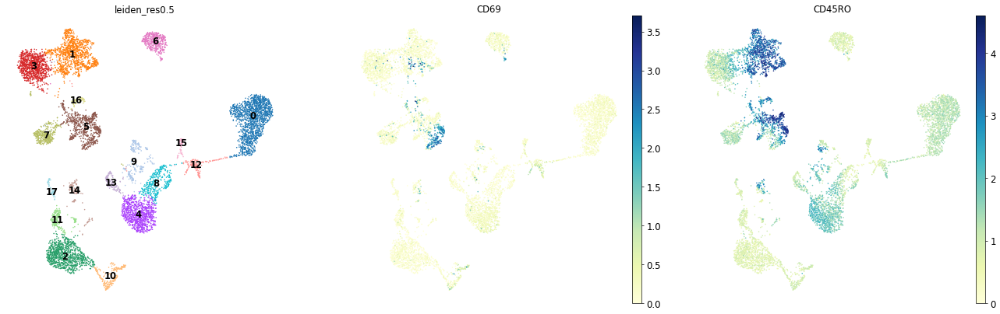

In [320]:
m_genes1 = marker_prots['CD8 T CD69+ CD45RO+']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1, legend_loc = 'on data')

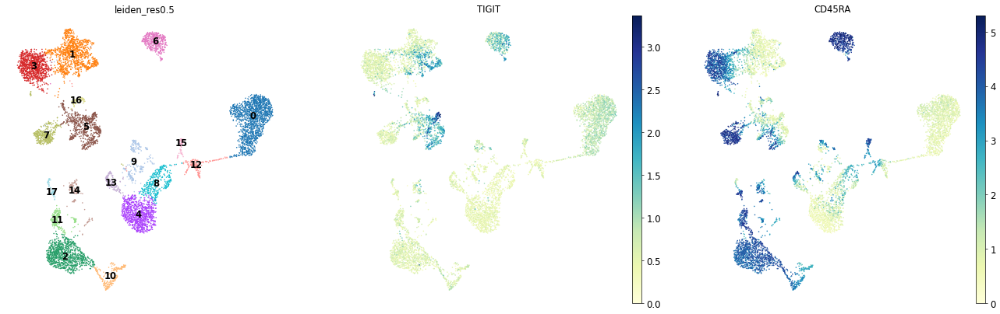

In [321]:
m_genes1 = marker_prots['CD8 T TIGIT+ CD45RA+']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1, legend_loc = 'on data')

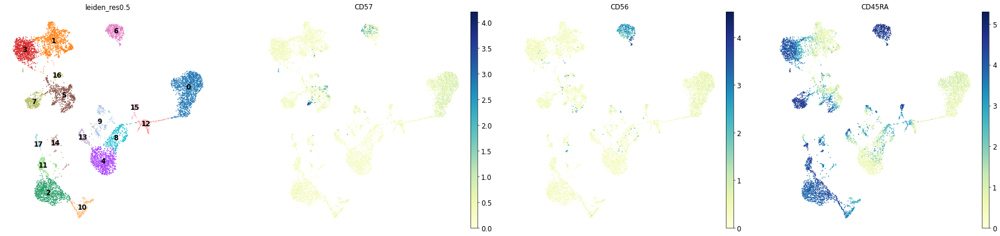

In [322]:
m_genes1 = marker_prots['CD8 T CD57+ CD45RA+']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1, legend_loc = 'on data')

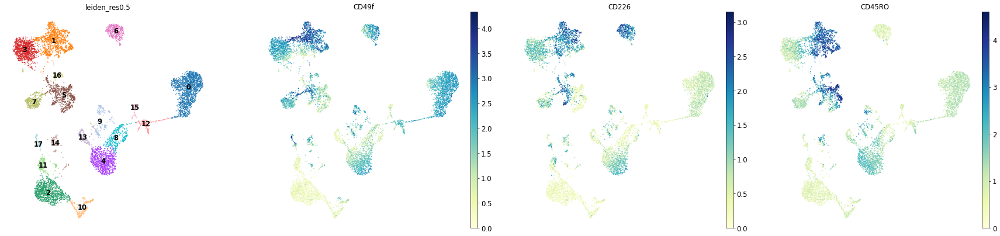

In [323]:
m_genes1 = marker_prots['CD8 T CD49f+']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1, legend_loc = 'on data')

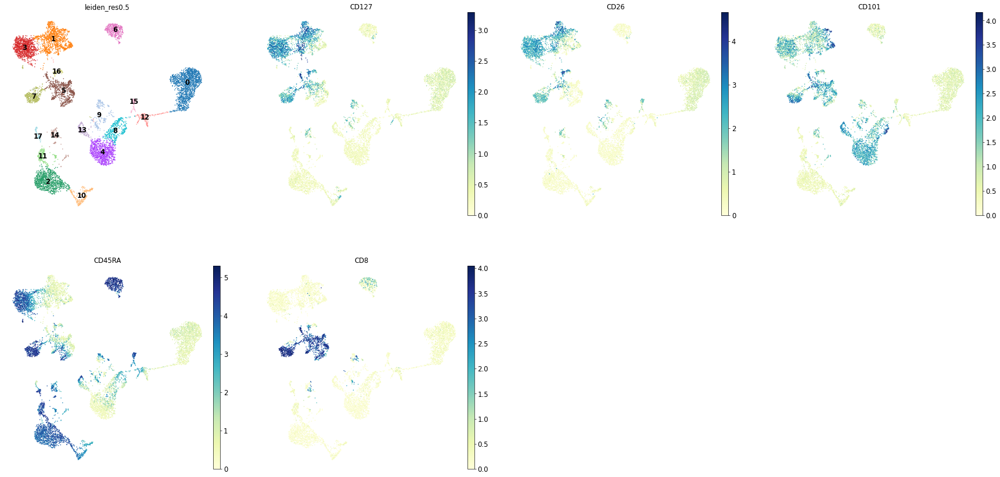

In [324]:
m_genes1 = marker_prots['CD8+ T naive CD127+ CD26+ CD101+']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1, legend_loc = 'on data')

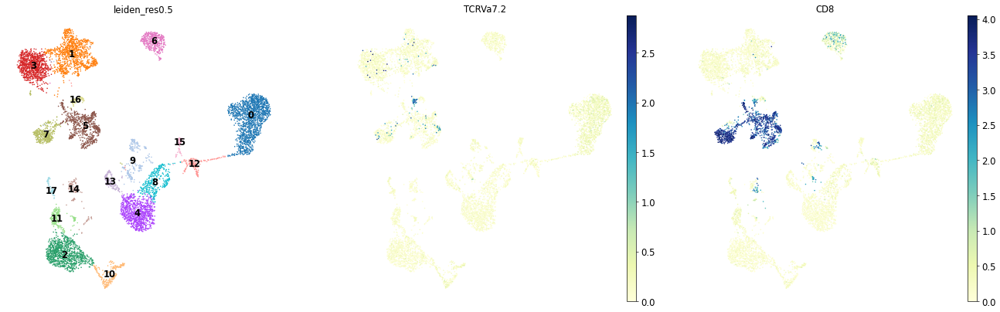

In [325]:
m_genes = marker_prots['MAIT']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes, legend_loc = 'on data')

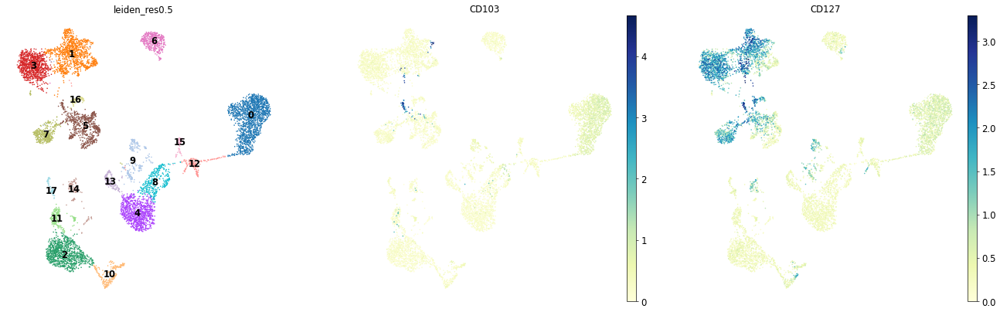

In [326]:
m_genes = marker_prots['ILC1']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes, legend_loc = 'on data')

In [327]:
orig_key = 'leiden_res0.5_sub' 
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '5'

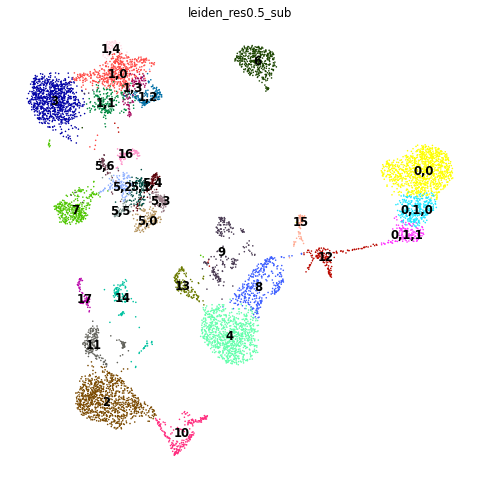

In [328]:
plt.rcParams['figure.figsize'] = (10,10)
res = 0.6
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key, legend_loc = 'on data')

plt.rcParams['figure.figsize'] = (7,7)

In [329]:
adata_adt.obs[new_key].value_counts()

0,0      990
2        967
3        966
4        860
1,0      528
6        418
7        369
8        360
0,1,0    317
9        235
10       229
1,1      204
11       192
12       166
1,2      150
0,1,1    141
13       140
5,0      137
14       130
5,1      129
5,2      115
5,3      104
1,3       95
5,4       90
1,4       84
15        79
16        74
5,5       72
17        69
5,6       45
Name: leiden_res0.5_sub, dtype: int64

### Cluster 7

In [330]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDC', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'naive CD20+ B', 'B1 B', 'transitional B', 'Plasma cell', 'Plasmablast', 'NK', 'NK CD158e1+', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog', 'CD4+ T naive', 'T reg', 'CD4+ T activated', 'CD4+ T activated CD279+', 'CD4+ T activated CD194+', 'CD4+ T activated integrinB7+', 'CD4+ T CD314+ CD45RA+', 'CD8+ T naive CD127+ CD26+ CD101+', 'CD8+ T naive CD127+ CD26- CD101-', 'ILC1', 'MAIT', 'gdT TCRVD2+', 'gdT CD56+', 'gdT Vd1 CD57+', 'gdT CD158b+ CD11c+', 'CD8 T CD49f+', 'CD8 T CD57+ CD45RO+', 'CD8 T CD57+ CD45RA+', 'CD8 T TIGIT+ CD45RO+', 'CD8 T TIGIT+ CD45RA+', 'CD8 T CD69+ CD45RO+', 'CD8 T CD69+ CD45RA+'])

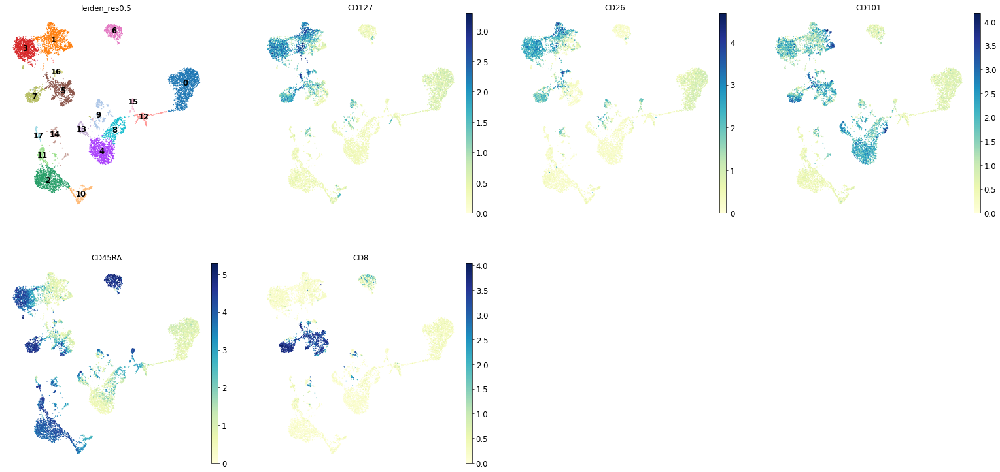

In [331]:
m_genes1 = marker_prots['CD8+ T naive CD127+ CD26+ CD101+']
#m_genes2 = marker_prots['CD8+ T naive CD127+ CD26- CD101-']
#m_genes3 = marker_prots['CD8+ T activated TIGIT+']

sc.pl.umap(adata_adt, color=[orig_res]+m_genes1, legend_loc = 'on data')#+m_genes2+m_genes3

### Cluster 16

In [332]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDC', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'naive CD20+ B', 'B1 B', 'transitional B', 'Plasma cell', 'Plasmablast', 'NK', 'NK CD158e1+', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog', 'CD4+ T naive', 'T reg', 'CD4+ T activated', 'CD4+ T activated CD279+', 'CD4+ T activated CD194+', 'CD4+ T activated integrinB7+', 'CD4+ T CD314+ CD45RA+', 'CD8+ T naive CD127+ CD26+ CD101+', 'CD8+ T naive CD127+ CD26- CD101-', 'ILC1', 'MAIT', 'gdT TCRVD2+', 'gdT CD56+', 'gdT Vd1 CD57+', 'gdT CD158b+ CD11c+', 'CD8 T CD49f+', 'CD8 T CD57+ CD45RO+', 'CD8 T CD57+ CD45RA+', 'CD8 T TIGIT+ CD45RO+', 'CD8 T TIGIT+ CD45RA+', 'CD8 T CD69+ CD45RO+', 'CD8 T CD69+ CD45RA+'])

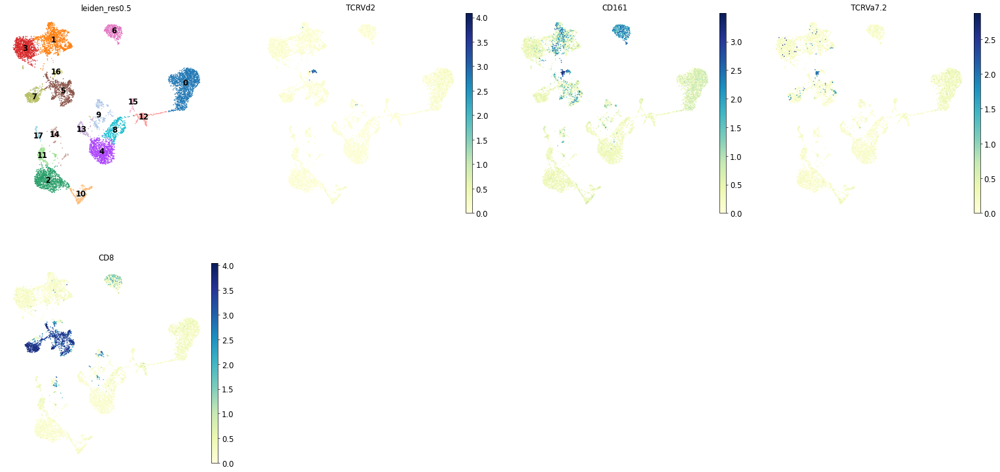

In [333]:
m_genes1 = marker_prots['gdT TCRVD2+']
m_genes2 = marker_prots['MAIT']
#m_genes3 = marker_prots['CD8+ T activated TIGIT+']

sc.pl.umap(adata_adt, color=[orig_res]+m_genes1+m_genes2, legend_loc = 'on data')#+m_genes2+m_genes3

In [334]:
orig_key = 'leiden_res0.5_sub' 
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '16'

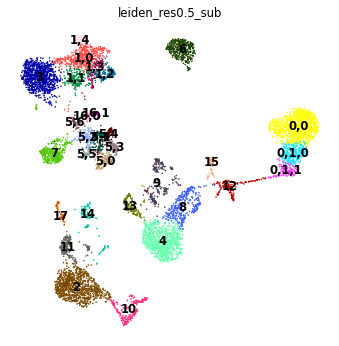

0,0      990
2        967
3        966
4        860
1,0      528
6        418
7        369
8        360
0,1,0    317
9        235
10       229
1,1      204
11       192
12       166
1,2      150
0,1,1    141
13       140
5,0      137
14       130
5,1      129
5,2      115
5,3      104
1,3       95
5,4       90
1,4       84
15        79
5,5       72
17        69
5,6       45
16,0      37
16,1      37
Name: leiden_res0.5_sub, dtype: int64

In [335]:
res = 0.2
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key, legend_loc = 'on data')
adata_adt.obs[new_key].value_counts()

### Cluster 6

In [336]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDC', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'naive CD20+ B', 'B1 B', 'transitional B', 'Plasma cell', 'Plasmablast', 'NK', 'NK CD158e1+', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog', 'CD4+ T naive', 'T reg', 'CD4+ T activated', 'CD4+ T activated CD279+', 'CD4+ T activated CD194+', 'CD4+ T activated integrinB7+', 'CD4+ T CD314+ CD45RA+', 'CD8+ T naive CD127+ CD26+ CD101+', 'CD8+ T naive CD127+ CD26- CD101-', 'ILC1', 'MAIT', 'gdT TCRVD2+', 'gdT CD56+', 'gdT Vd1 CD57+', 'gdT CD158b+ CD11c+', 'CD8 T CD49f+', 'CD8 T CD57+ CD45RO+', 'CD8 T CD57+ CD45RA+', 'CD8 T TIGIT+ CD45RO+', 'CD8 T TIGIT+ CD45RA+', 'CD8 T CD69+ CD45RO+', 'CD8 T CD69+ CD45RA+'])

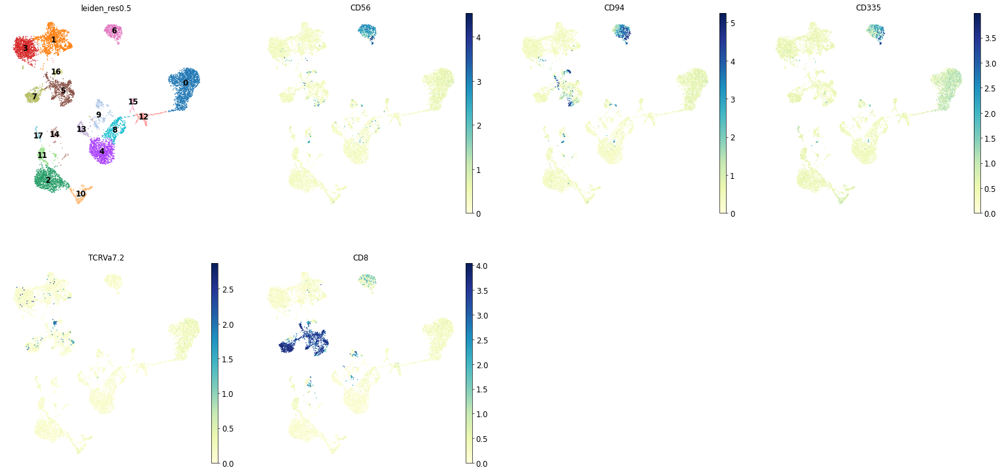

In [337]:
m_genes1 = marker_prots['NK']
m_genes2 = marker_prots['MAIT']
#m_genes3 = marker_prots['CD8+ T activated TIGIT+']

sc.pl.umap(adata_adt, color=[orig_res]+m_genes1+m_genes2, legend_loc = 'on data')#+m_genes2+m_genes3

### Summary

- Overlapping erythrocyte stages

In [338]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDC', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'naive CD20+ B', 'B1 B', 'transitional B', 'Plasma cell', 'Plasmablast', 'NK', 'NK CD158e1+', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog', 'CD4+ T naive', 'T reg', 'CD4+ T activated', 'CD4+ T activated CD279+', 'CD4+ T activated CD194+', 'CD4+ T activated integrinB7+', 'CD4+ T CD314+ CD45RA+', 'CD8+ T naive CD127+ CD26+ CD101+', 'CD8+ T naive CD127+ CD26- CD101-', 'ILC1', 'MAIT', 'gdT TCRVD2+', 'gdT CD56+', 'gdT Vd1 CD57+', 'gdT CD158b+ CD11c+', 'CD8 T CD49f+', 'CD8 T CD57+ CD45RO+', 'CD8 T CD57+ CD45RA+', 'CD8 T TIGIT+ CD45RO+', 'CD8 T TIGIT+ CD45RA+', 'CD8 T CD69+ CD45RO+', 'CD8 T CD69+ CD45RA+'])

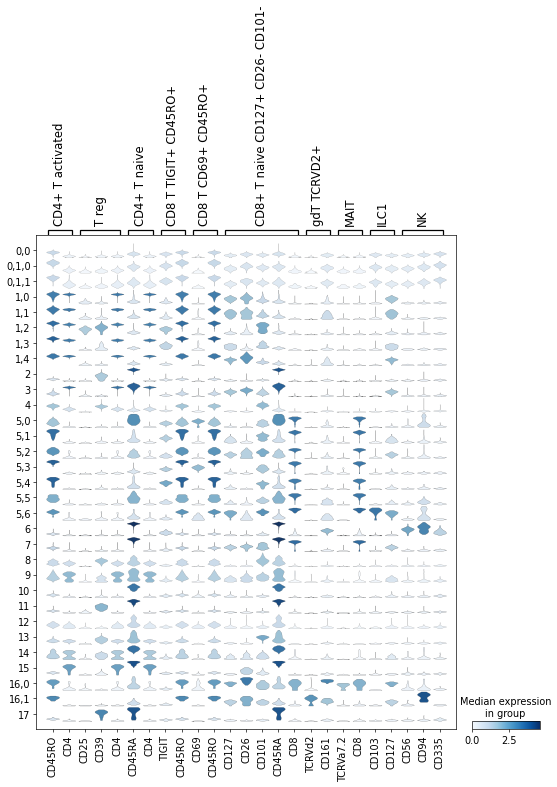

In [339]:
sc.pl.stacked_violin(adata_adt, var_names={a:marker_prots[a] for a in ['CD4+ T activated',
                                                                      'T reg',
                                                                      'CD4+ T naive',
                                                                      'CD8 T TIGIT+ CD45RO+',
                                                                      'CD8 T CD69+ CD45RO+',
                                                                      'CD8+ T naive CD127+ CD26- CD101-',
                                                                      'gdT TCRVD2+','MAIT','ILC1', 'NK']}, groupby=new_key)

## B lineage

### Cluster 2

In [340]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDC', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'naive CD20+ B', 'B1 B', 'transitional B', 'Plasma cell', 'Plasmablast', 'NK', 'NK CD158e1+', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog', 'CD4+ T naive', 'T reg', 'CD4+ T activated', 'CD4+ T activated CD279+', 'CD4+ T activated CD194+', 'CD4+ T activated integrinB7+', 'CD4+ T CD314+ CD45RA+', 'CD8+ T naive CD127+ CD26+ CD101+', 'CD8+ T naive CD127+ CD26- CD101-', 'ILC1', 'MAIT', 'gdT TCRVD2+', 'gdT CD56+', 'gdT Vd1 CD57+', 'gdT CD158b+ CD11c+', 'CD8 T CD49f+', 'CD8 T CD57+ CD45RO+', 'CD8 T CD57+ CD45RA+', 'CD8 T TIGIT+ CD45RO+', 'CD8 T TIGIT+ CD45RA+', 'CD8 T CD69+ CD45RO+', 'CD8 T CD69+ CD45RA+'])

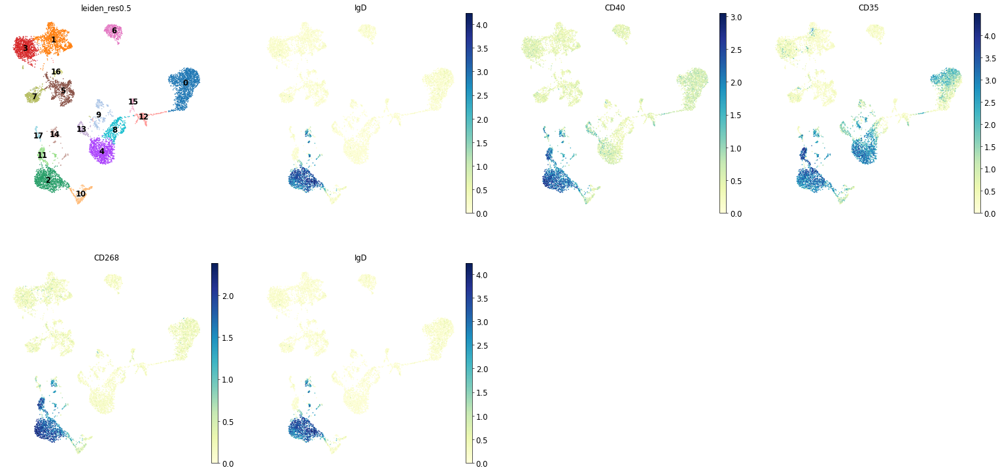

In [341]:
m_genes1 = marker_prots['naive CD20+ B']
m_genes2 = marker_prots['B1 B']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1+m_genes2, legend_loc = 'on data')#+m_genes2

### Cluster 10

In [342]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDC', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'naive CD20+ B', 'B1 B', 'transitional B', 'Plasma cell', 'Plasmablast', 'NK', 'NK CD158e1+', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog', 'CD4+ T naive', 'T reg', 'CD4+ T activated', 'CD4+ T activated CD279+', 'CD4+ T activated CD194+', 'CD4+ T activated integrinB7+', 'CD4+ T CD314+ CD45RA+', 'CD8+ T naive CD127+ CD26+ CD101+', 'CD8+ T naive CD127+ CD26- CD101-', 'ILC1', 'MAIT', 'gdT TCRVD2+', 'gdT CD56+', 'gdT Vd1 CD57+', 'gdT CD158b+ CD11c+', 'CD8 T CD49f+', 'CD8 T CD57+ CD45RO+', 'CD8 T CD57+ CD45RA+', 'CD8 T TIGIT+ CD45RO+', 'CD8 T TIGIT+ CD45RA+', 'CD8 T CD69+ CD45RO+', 'CD8 T CD69+ CD45RA+'])

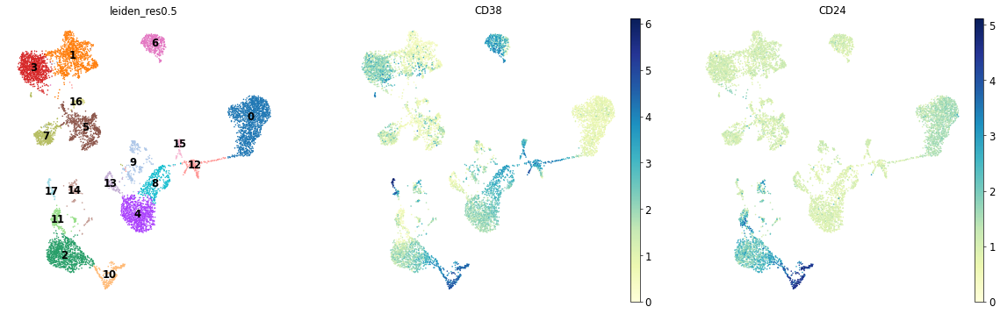

In [343]:
m_genes1 = marker_prots['transitional B']
#m_genes2 = marker_prots['Treg']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1, legend_loc = 'on data')#+m_genes2

In [344]:
orig_key = 'leiden_res0.5_sub' 
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '10'

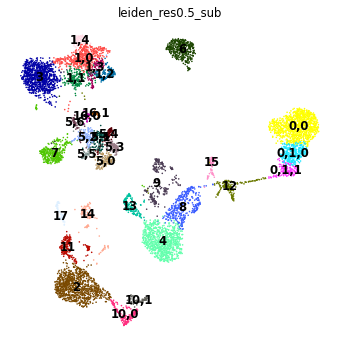

0,0      990
2        967
3        966
4        860
1,0      528
6        418
7        369
8        360
0,1,0    317
9        235
1,1      204
11       192
12       166
10,0     156
1,2      150
0,1,1    141
13       140
5,0      137
14       130
5,1      129
5,2      115
5,3      104
1,3       95
5,4       90
1,4       84
15        79
10,1      73
5,5       72
17        69
5,6       45
16,0      37
16,1      37
Name: leiden_res0.5_sub, dtype: int64

In [345]:
res = 0.1
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key, legend_loc = 'on data')
adata_adt.obs[new_key].value_counts()

### Cluster 11

In [346]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDC', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'naive CD20+ B', 'B1 B', 'transitional B', 'Plasma cell', 'Plasmablast', 'NK', 'NK CD158e1+', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog', 'CD4+ T naive', 'T reg', 'CD4+ T activated', 'CD4+ T activated CD279+', 'CD4+ T activated CD194+', 'CD4+ T activated integrinB7+', 'CD4+ T CD314+ CD45RA+', 'CD8+ T naive CD127+ CD26+ CD101+', 'CD8+ T naive CD127+ CD26- CD101-', 'ILC1', 'MAIT', 'gdT TCRVD2+', 'gdT CD56+', 'gdT Vd1 CD57+', 'gdT CD158b+ CD11c+', 'CD8 T CD49f+', 'CD8 T CD57+ CD45RO+', 'CD8 T CD57+ CD45RA+', 'CD8 T TIGIT+ CD45RO+', 'CD8 T TIGIT+ CD45RA+', 'CD8 T CD69+ CD45RO+', 'CD8 T CD69+ CD45RA+'])

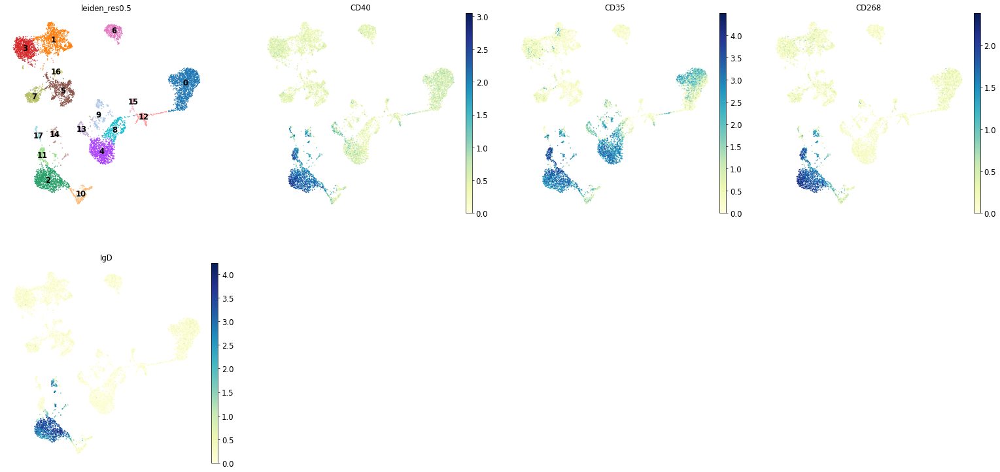

In [347]:
m_genes1 = marker_prots['B1 B']
#m_genes2 = marker_prots['Treg']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1, legend_loc = 'on data')#+m_genes2

In [348]:
orig_key = 'leiden_res0.5_sub' 
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '11'

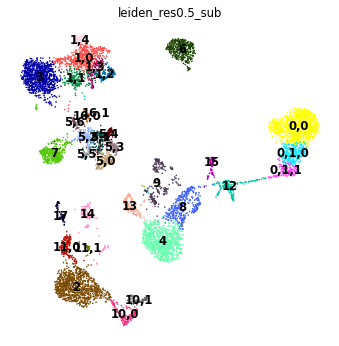

0,0      990
2        967
3        966
4        860
1,0      528
6        418
7        369
8        360
0,1,0    317
9        235
1,1      204
12       166
11,0     160
10,0     156
1,2      150
0,1,1    141
13       140
5,0      137
14       130
5,1      129
5,2      115
5,3      104
1,3       95
5,4       90
1,4       84
15        79
10,1      73
5,5       72
17        69
5,6       45
16,0      37
16,1      37
11,1      32
Name: leiden_res0.5_sub, dtype: int64

In [349]:
res = 0.2
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key, legend_loc = 'on data')
adata_adt.obs[new_key].value_counts()

### Cluster 17

In [350]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDC', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'naive CD20+ B', 'B1 B', 'transitional B', 'Plasma cell', 'Plasmablast', 'NK', 'NK CD158e1+', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog', 'CD4+ T naive', 'T reg', 'CD4+ T activated', 'CD4+ T activated CD279+', 'CD4+ T activated CD194+', 'CD4+ T activated integrinB7+', 'CD4+ T CD314+ CD45RA+', 'CD8+ T naive CD127+ CD26+ CD101+', 'CD8+ T naive CD127+ CD26- CD101-', 'ILC1', 'MAIT', 'gdT TCRVD2+', 'gdT CD56+', 'gdT Vd1 CD57+', 'gdT CD158b+ CD11c+', 'CD8 T CD49f+', 'CD8 T CD57+ CD45RO+', 'CD8 T CD57+ CD45RA+', 'CD8 T TIGIT+ CD45RO+', 'CD8 T TIGIT+ CD45RA+', 'CD8 T CD69+ CD45RO+', 'CD8 T CD69+ CD45RA+'])

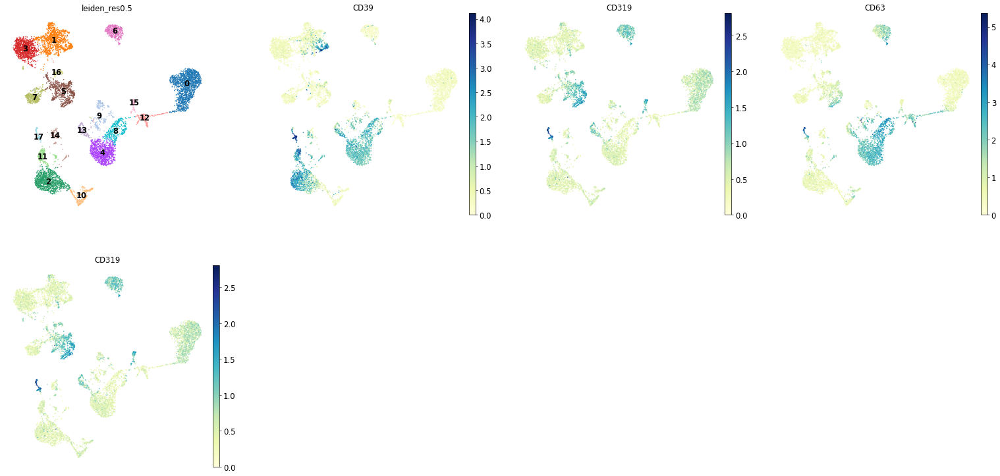

In [351]:
m_genes1 = marker_prots['Plasmablast']
m_genes2 = marker_prots['Plasma cell']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1+m_genes2, legend_loc = 'on data')#+m_genes2

In [352]:
orig_key = 'leiden_res0.5_sub' 
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '17'

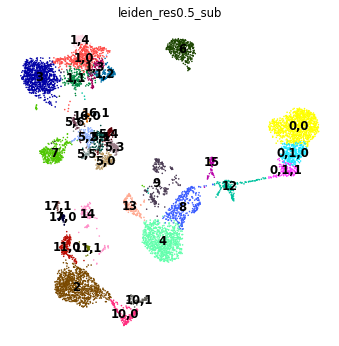

0,0      990
2        967
3        966
4        860
1,0      528
6        418
7        369
8        360
0,1,0    317
9        235
1,1      204
12       166
11,0     160
10,0     156
1,2      150
0,1,1    141
13       140
5,0      137
14       130
5,1      129
5,2      115
5,3      104
1,3       95
5,4       90
1,4       84
15        79
10,1      73
5,5       72
17,0      46
5,6       45
16,0      37
16,1      37
11,1      32
17,1      23
Name: leiden_res0.5_sub, dtype: int64

In [353]:
res = 0.2
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key, legend_loc = 'on data')
adata_adt.obs[new_key].value_counts()

## Mono / DCs

### Cluster 4

In [354]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDC', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'naive CD20+ B', 'B1 B', 'transitional B', 'Plasma cell', 'Plasmablast', 'NK', 'NK CD158e1+', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog', 'CD4+ T naive', 'T reg', 'CD4+ T activated', 'CD4+ T activated CD279+', 'CD4+ T activated CD194+', 'CD4+ T activated integrinB7+', 'CD4+ T CD314+ CD45RA+', 'CD8+ T naive CD127+ CD26+ CD101+', 'CD8+ T naive CD127+ CD26- CD101-', 'ILC1', 'MAIT', 'gdT TCRVD2+', 'gdT CD56+', 'gdT Vd1 CD57+', 'gdT CD158b+ CD11c+', 'CD8 T CD49f+', 'CD8 T CD57+ CD45RO+', 'CD8 T CD57+ CD45RA+', 'CD8 T TIGIT+ CD45RO+', 'CD8 T TIGIT+ CD45RA+', 'CD8 T CD69+ CD45RO+', 'CD8 T CD69+ CD45RA+'])

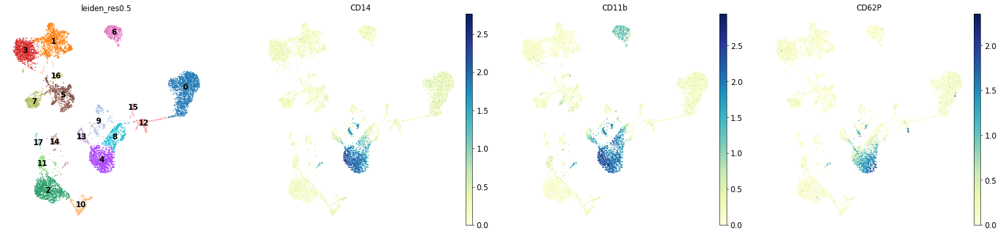

In [355]:
m_genes1 = marker_prots['CD14+ Mono']
#m_genes2 = marker_prots['Treg']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1, legend_loc = 'on data')#+m_genes2

### Cluster 8

In [356]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDC', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'naive CD20+ B', 'B1 B', 'transitional B', 'Plasma cell', 'Plasmablast', 'NK', 'NK CD158e1+', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog', 'CD4+ T naive', 'T reg', 'CD4+ T activated', 'CD4+ T activated CD279+', 'CD4+ T activated CD194+', 'CD4+ T activated integrinB7+', 'CD4+ T CD314+ CD45RA+', 'CD8+ T naive CD127+ CD26+ CD101+', 'CD8+ T naive CD127+ CD26- CD101-', 'ILC1', 'MAIT', 'gdT TCRVD2+', 'gdT CD56+', 'gdT Vd1 CD57+', 'gdT CD158b+ CD11c+', 'CD8 T CD49f+', 'CD8 T CD57+ CD45RO+', 'CD8 T CD57+ CD45RA+', 'CD8 T TIGIT+ CD45RO+', 'CD8 T TIGIT+ CD45RA+', 'CD8 T CD69+ CD45RO+', 'CD8 T CD69+ CD45RA+'])

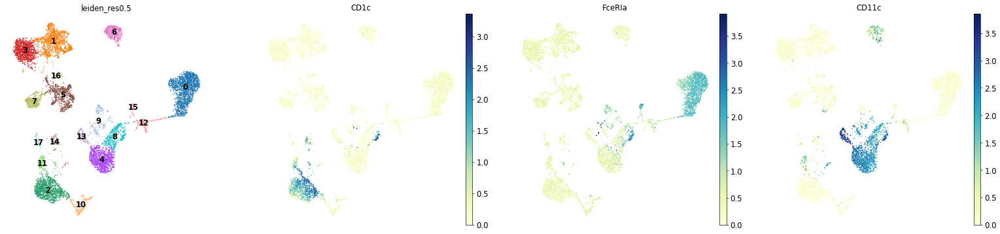

In [357]:
m_genes1 = marker_prots['cDC2']
#m_genes2 = marker_prots['Treg']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1, legend_loc = 'on data')#+m_genes2

In [358]:
orig_key = 'leiden_res0.5_sub' 
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '8'

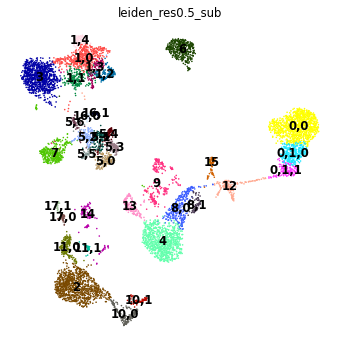

0,0      990
2        967
3        966
4        860
1,0      528
6        418
7        369
0,1,0    317
8,0      288
9        235
1,1      204
12       166
11,0     160
10,0     156
1,2      150
0,1,1    141
13       140
5,0      137
14       130
5,1      129
5,2      115
5,3      104
1,3       95
5,4       90
1,4       84
15        79
10,1      73
5,5       72
8,1       72
17,0      46
5,6       45
16,0      37
16,1      37
11,1      32
17,1      23
Name: leiden_res0.5_sub, dtype: int64

In [359]:
res = 0.1
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key, legend_loc = 'on data')
adata_adt.obs[new_key].value_counts()

### Cluster 13

In [360]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDC', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'naive CD20+ B', 'B1 B', 'transitional B', 'Plasma cell', 'Plasmablast', 'NK', 'NK CD158e1+', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog', 'CD4+ T naive', 'T reg', 'CD4+ T activated', 'CD4+ T activated CD279+', 'CD4+ T activated CD194+', 'CD4+ T activated integrinB7+', 'CD4+ T CD314+ CD45RA+', 'CD8+ T naive CD127+ CD26+ CD101+', 'CD8+ T naive CD127+ CD26- CD101-', 'ILC1', 'MAIT', 'gdT TCRVD2+', 'gdT CD56+', 'gdT Vd1 CD57+', 'gdT CD158b+ CD11c+', 'CD8 T CD49f+', 'CD8 T CD57+ CD45RO+', 'CD8 T CD57+ CD45RA+', 'CD8 T TIGIT+ CD45RO+', 'CD8 T TIGIT+ CD45RA+', 'CD8 T CD69+ CD45RO+', 'CD8 T CD69+ CD45RA+'])

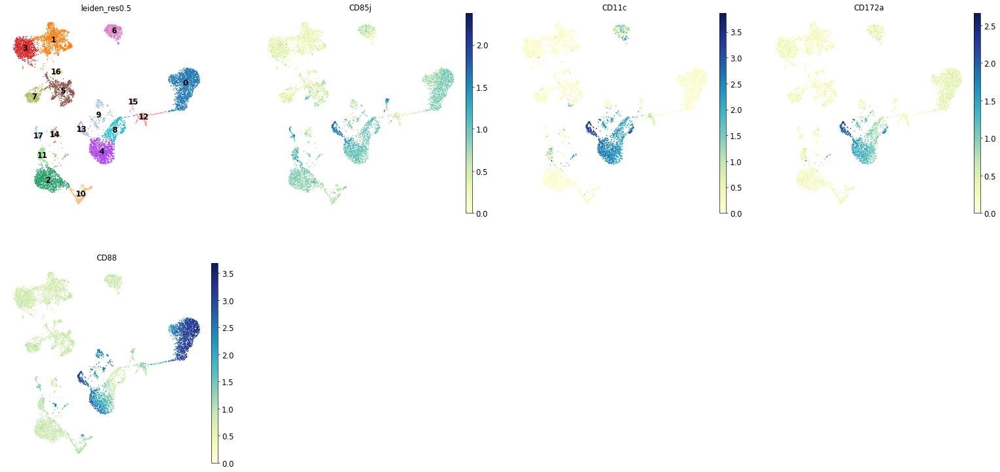

In [361]:
m_genes1 = marker_prots['CD16+ Mono']
#m_genes2 = marker_prots['Treg']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1, legend_loc = 'on data')#+m_genes2

### Cluster 15

In [362]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDC', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'naive CD20+ B', 'B1 B', 'transitional B', 'Plasma cell', 'Plasmablast', 'NK', 'NK CD158e1+', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog', 'CD4+ T naive', 'T reg', 'CD4+ T activated', 'CD4+ T activated CD279+', 'CD4+ T activated CD194+', 'CD4+ T activated integrinB7+', 'CD4+ T CD314+ CD45RA+', 'CD8+ T naive CD127+ CD26+ CD101+', 'CD8+ T naive CD127+ CD26- CD101-', 'ILC1', 'MAIT', 'gdT TCRVD2+', 'gdT CD56+', 'gdT Vd1 CD57+', 'gdT CD158b+ CD11c+', 'CD8 T CD49f+', 'CD8 T CD57+ CD45RO+', 'CD8 T CD57+ CD45RA+', 'CD8 T TIGIT+ CD45RO+', 'CD8 T TIGIT+ CD45RA+', 'CD8 T CD69+ CD45RO+', 'CD8 T CD69+ CD45RA+'])

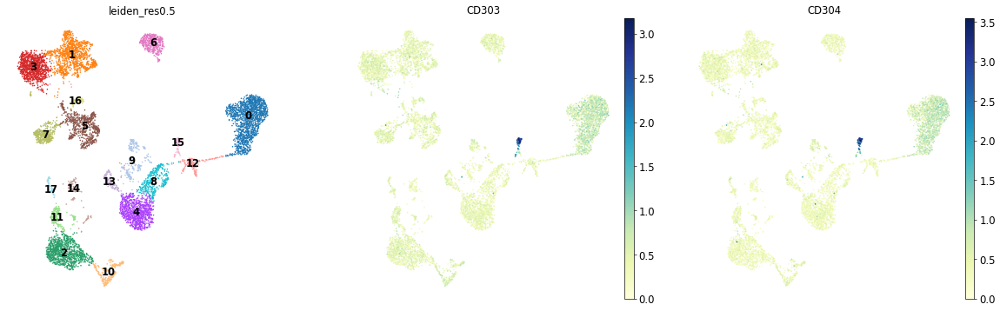

In [364]:
m_genes1 = marker_prots['pDC']
#m_genes2 = marker_prots['Treg']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1, legend_loc = 'on data')#+m_genes2

## Stem

### Cluster 12

In [365]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDC', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'naive CD20+ B', 'B1 B', 'transitional B', 'Plasma cell', 'Plasmablast', 'NK', 'NK CD158e1+', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog', 'CD4+ T naive', 'T reg', 'CD4+ T activated', 'CD4+ T activated CD279+', 'CD4+ T activated CD194+', 'CD4+ T activated integrinB7+', 'CD4+ T CD314+ CD45RA+', 'CD8+ T naive CD127+ CD26+ CD101+', 'CD8+ T naive CD127+ CD26- CD101-', 'ILC1', 'MAIT', 'gdT TCRVD2+', 'gdT CD56+', 'gdT Vd1 CD57+', 'gdT CD158b+ CD11c+', 'CD8 T CD49f+', 'CD8 T CD57+ CD45RO+', 'CD8 T CD57+ CD45RA+', 'CD8 T TIGIT+ CD45RO+', 'CD8 T TIGIT+ CD45RA+', 'CD8 T CD69+ CD45RO+', 'CD8 T CD69+ CD45RA+'])

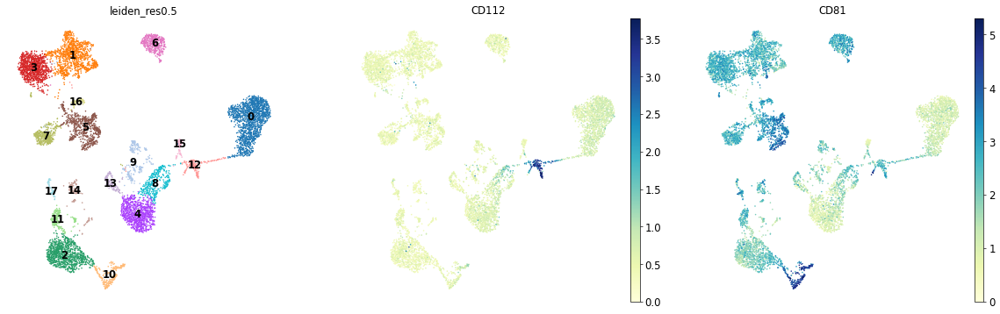

In [366]:
#m_genes1 = marker_prots['HSC (MK/E G/M) prog']
m_genes2 = marker_prots['Lymph prog']
#m_genes3 = marker_prots['G/M prog']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes2, legend_loc = 'on data')

In [367]:
orig_key = 'leiden_res0.5_sub' 
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '12'

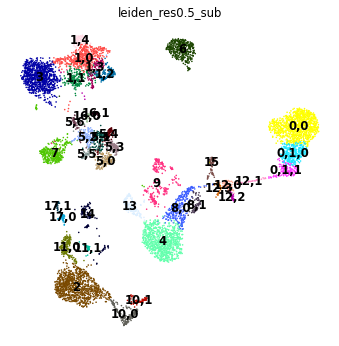

0,0      990
2        967
3        966
4        860
1,0      528
6        418
7        369
0,1,0    317
8,0      288
9        235
1,1      204
11,0     160
10,0     156
1,2      150
0,1,1    141
13       140
5,0      137
14       130
5,1      129
5,2      115
5,3      104
1,3       95
5,4       90
1,4       84
15        79
12,0      76
10,1      73
8,1       72
5,5       72
17,0      46
5,6       45
16,0      37
16,1      37
12,1      36
11,1      32
12,2      31
12,3      23
17,1      23
Name: leiden_res0.5_sub, dtype: int64

In [368]:
res = 0.3
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key, legend_loc = 'on data')
adata_adt.obs[new_key].value_counts()

In [369]:
orig_key = 'leiden_res0.5_sub' 
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '12,3'

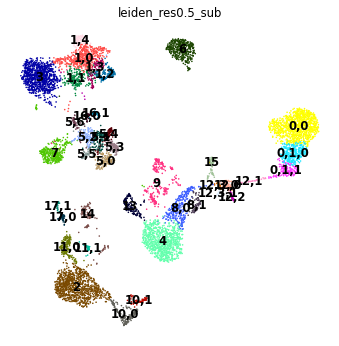

0,0       990
2         967
3         966
4         860
1,0       528
6         418
7         369
0,1,0     317
8,0       288
9         235
1,1       204
11,0      160
10,0      156
1,2       150
0,1,1     141
13        140
5,0       137
14        130
5,1       129
5,2       115
5,3       104
1,3        95
5,4        90
1,4        84
15         79
12,0       76
10,1       73
8,1        72
5,5        72
17,0       46
5,6        45
16,0       37
16,1       37
12,1       36
11,1       32
12,2       31
17,1       23
12,3,0     13
12,3,1     10
Name: leiden_res0.5_sub, dtype: int64

In [370]:
res = 0.3
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key, legend_loc = 'on data')
adata_adt.obs[new_key].value_counts()

## Cluster dictionary

In [371]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDC', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'naive CD20+ B', 'B1 B', 'transitional B', 'Plasma cell', 'Plasmablast', 'NK', 'NK CD158e1+', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog', 'CD4+ T naive', 'T reg', 'CD4+ T activated', 'CD4+ T activated CD279+', 'CD4+ T activated CD194+', 'CD4+ T activated integrinB7+', 'CD4+ T CD314+ CD45RA+', 'CD8+ T naive CD127+ CD26+ CD101+', 'CD8+ T naive CD127+ CD26- CD101-', 'ILC1', 'MAIT', 'gdT TCRVD2+', 'gdT CD56+', 'gdT Vd1 CD57+', 'gdT CD158b+ CD11c+', 'CD8 T CD49f+', 'CD8 T CD57+ CD45RO+', 'CD8 T CD57+ CD45RA+', 'CD8 T TIGIT+ CD45RO+', 'CD8 T TIGIT+ CD45RA+', 'CD8 T CD69+ CD45RO+', 'CD8 T CD69+ CD45RA+'])

In [372]:
rename_clust_dict = {
    
    '0,0':'Normoblast/Reticulocyte', # Potentially cluster to left is Reticulocyte, rest Normoblast
    '0,1,0':'Erythroblast',
    '0,1,1':'Proerythroblast',
    
    '1,0':'CD4+ T activated',
    '1,1':'CD4+ T activated integrinB7+',
    '1,2':'T reg',
    '1,3':'CD4+ T activated CD279+',
    '1,4':'CD4+ T activated',
    
    '2':'Naive CD20+ B',
    '3':'CD4+ T naive',
    '4':'CD14+ Mono',
    
    '5,0':'CD8 T CD69+ CD45RA+',
    '5,1':'CD8 T TIGIT+ CD45RA+',
    '5,2':'CD8 T CD49f+',
    '5,3':'CD8 T CD69+ CD45RO+',
    '5,4':'CD8 T TIGIT+ CD45RO+',
    '5,5':'CD8 T CD57+ CD45RA+',
    '5,6':'ILC1',
    
    '6':'NK',
    '7':'CD8+ T naive',
    '8,0':'pot doublet',
    '8,1':'cDC2',
    '9':'doublet',
    '10,0':'Transitional B - 1',
    '10,1':'Transitional B - CD31+ (doublet?)',
    '11,0':'B1 B - 1',
    '11,1':'B1 B - 2 (doublet?)',
    '12,0':'HSC',
    '12,1':'MK/E prog',
    '12,2':'HSC',
    '12,3,0':'G/M prog',
    '12,3,1':'Lymph prog',
    '13':'CD16+ Mono',
    '14':'doublet',
    '15':'pDC',
    '16,0':'MAIT', # not 100% sure
    '16,1':'gdT TCRVD2+',
    '17,0':'Plasmablast',
    '17,1':'Plasma cells'

    
}

In [373]:
adata_adt.obs['leiden_final'] = adata_adt.obs['leiden_res0.5_sub'].map(rename_clust_dict)

In [374]:
adata_adt.obs['leiden_final'].value_counts()

Normoblast/Reticulocyte              990
Naive CD20+ B                        967
CD4+ T naive                         966
CD14+ Mono                           860
CD4+ T activated                     612
NK                                   418
CD8+ T naive                         369
doublet                              365
Erythroblast                         317
pot doublet                          288
CD4+ T activated integrinB7+         204
B1 B - 1                             160
Transitional B - 1                   156
T reg                                150
Proerythroblast                      141
CD16+ Mono                           140
CD8 T CD69+ CD45RA+                  137
CD8 T TIGIT+ CD45RA+                 129
CD8 T CD49f+                         115
HSC                                  107
CD8 T CD69+ CD45RO+                  104
CD4+ T activated CD279+               95
CD8 T TIGIT+ CD45RO+                  90
pDC                                   79
Transitional B -

In [375]:
adata_adt

AnnData object with n_obs × n_vars = 8455 × 140
    obs: 'n_antibodies_by_counts', 'log1p_n_antibodies_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_5_antibodies', 'pct_counts_in_top_10_antibodies', 'iso_count', 'iso_count_col', 'log_iso_count', 'iso_count_fltr', 'n_counts', 'leiden', 'leiden_res0.3', 'leiden_res0.5', 'leiden_res0.8', 'leiden_res1', 'doublet_score', 'predicted_doublet', 'leiden_res0.5_sub', 'leiden_temp', 'leiden_final'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'iso_count_fltr_colors', 'pca', 'neighbors', 'leiden', 'umap', 'leiden_res0.3_colors', 'leiden_res0.5_colors', 'leiden_res0.8_colors', 'leiden_res1_colors', 'predicted_doublet_colors', 'rank_leiden_res0.5', 'leiden_res0.5_sub_colors', 'leiden_temp_colors', 'leiden_final_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'dista

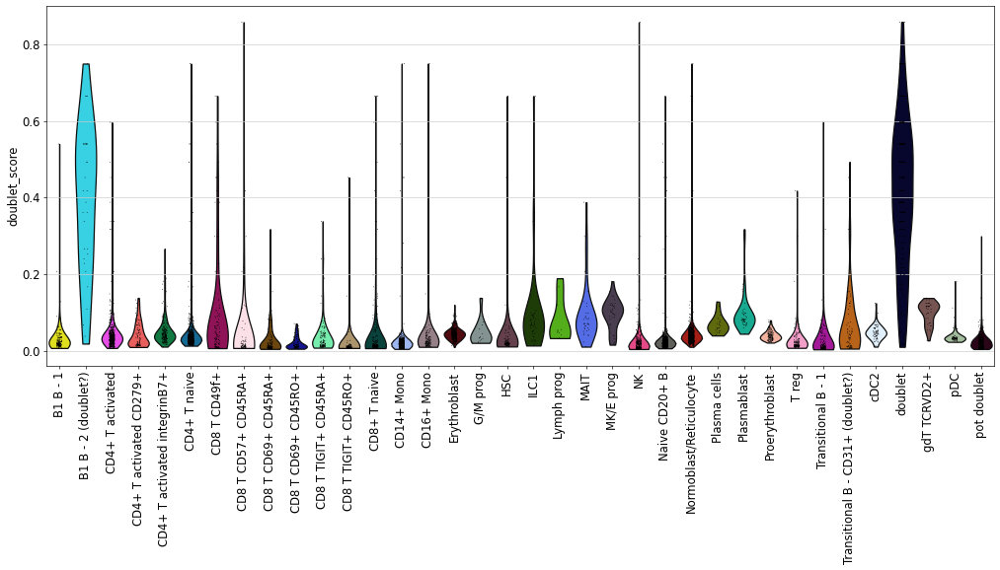

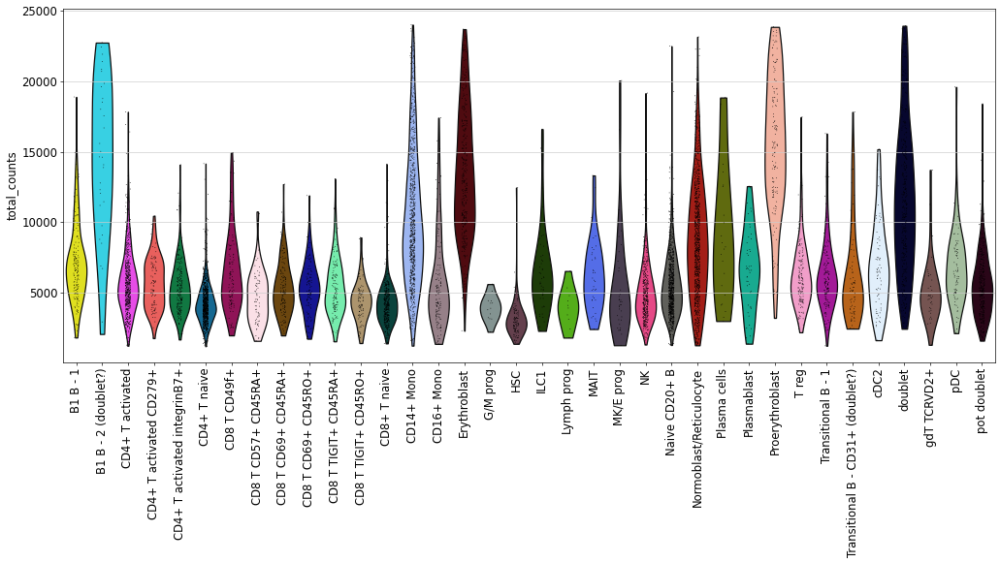

In [379]:
plt.rcParams['figure.figsize']=(16,8)
sc.pl.violin(adata_adt, keys='doublet_score', groupby='leiden_final', rotation=90)
sc.pl.violin(adata_adt, keys='total_counts', groupby='leiden_final', rotation=90)
plt.rcParams['figure.figsize']=(7,7)


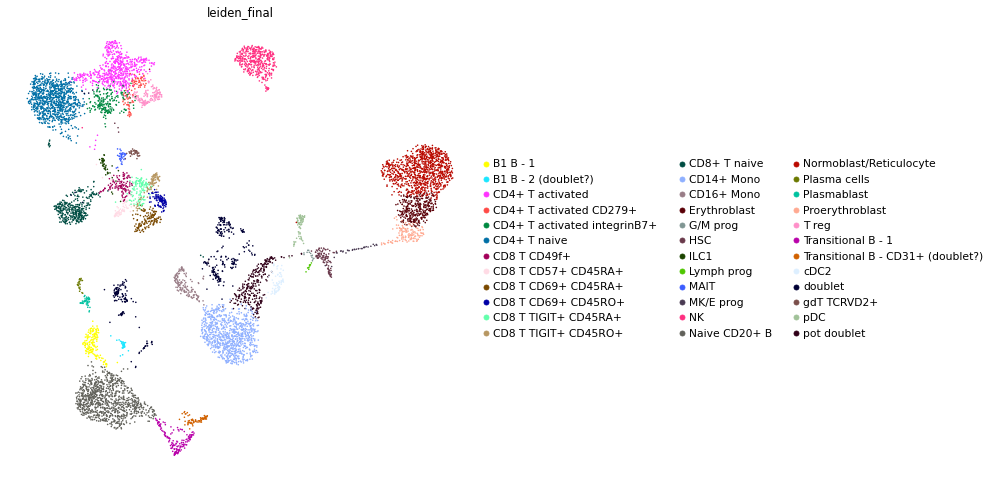

In [380]:
plt.rcParams['figure.figsize'] = (10,10)
sc.pl.umap(adata_adt, color='leiden_final')
plt.rcParams['figure.figsize'] = (8,8)

## Doublet filtering

In [381]:
adata_adt.obs['leiden_final'].value_counts()

Normoblast/Reticulocyte              990
Naive CD20+ B                        967
CD4+ T naive                         966
CD14+ Mono                           860
CD4+ T activated                     612
NK                                   418
CD8+ T naive                         369
doublet                              365
Erythroblast                         317
pot doublet                          288
CD4+ T activated integrinB7+         204
B1 B - 1                             160
Transitional B - 1                   156
T reg                                150
Proerythroblast                      141
CD16+ Mono                           140
CD8 T CD69+ CD45RA+                  137
CD8 T TIGIT+ CD45RA+                 129
CD8 T CD49f+                         115
HSC                                  107
CD8 T CD69+ CD45RO+                  104
CD4+ T activated CD279+               95
CD8 T TIGIT+ CD45RO+                  90
pDC                                   79
Transitional B -

In [382]:
print((32+365)/8455)  # B1 B - 2 (doublet?) + doublet
print((32+365 + 288)/8455)  # B1 B - 2 (doublet?) + doublet + pot doublet 

0.04695446481371969
0.08101714961561206


In [383]:
adata_adt_filt = adata_adt[[c not in ['doublet', 'B1 B - 2 (doublet?)'] for c in adata_adt.obs['leiden_final']],:]

In [384]:
adata_adt_filt

View of AnnData object with n_obs × n_vars = 8058 × 140
    obs: 'n_antibodies_by_counts', 'log1p_n_antibodies_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_5_antibodies', 'pct_counts_in_top_10_antibodies', 'iso_count', 'iso_count_col', 'log_iso_count', 'iso_count_fltr', 'n_counts', 'leiden', 'leiden_res0.3', 'leiden_res0.5', 'leiden_res0.8', 'leiden_res1', 'doublet_score', 'predicted_doublet', 'leiden_res0.5_sub', 'leiden_temp', 'leiden_final'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'iso_count_fltr_colors', 'pca', 'neighbors', 'leiden', 'umap', 'leiden_res0.3_colors', 'leiden_res0.5_colors', 'leiden_res0.8_colors', 'leiden_res1_colors', 'predicted_doublet_colors', 'rank_leiden_res0.5', 'leiden_res0.5_sub_colors', 'leiden_temp_colors', 'leiden_final_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp

In [ ]:
plt.rcParams['figure.figsize'] = (10,10)
sc.pl.umap(adata_adt_filt, color='leiden_final')
plt.rcParams['figure.figsize'] = (8,8)

# Marker overview

In [386]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDC', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'naive CD20+ B', 'B1 B', 'transitional B', 'Plasma cell', 'Plasmablast', 'NK', 'NK CD158e1+', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog', 'CD4+ T naive', 'T reg', 'CD4+ T activated', 'CD4+ T activated CD279+', 'CD4+ T activated CD194+', 'CD4+ T activated integrinB7+', 'CD4+ T CD314+ CD45RA+', 'CD8+ T naive CD127+ CD26+ CD101+', 'CD8+ T naive CD127+ CD26- CD101-', 'ILC1', 'MAIT', 'gdT TCRVD2+', 'gdT CD56+', 'gdT Vd1 CD57+', 'gdT CD158b+ CD11c+', 'CD8 T CD49f+', 'CD8 T CD57+ CD45RO+', 'CD8 T CD57+ CD45RA+', 'CD8 T TIGIT+ CD45RO+', 'CD8 T TIGIT+ CD45RA+', 'CD8 T CD69+ CD45RO+', 'CD8 T CD69+ CD45RA+'])

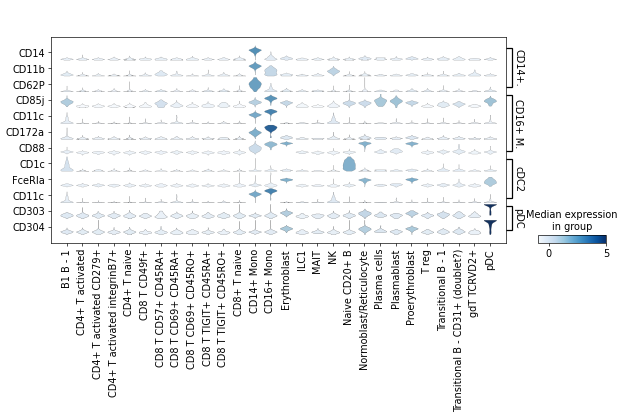

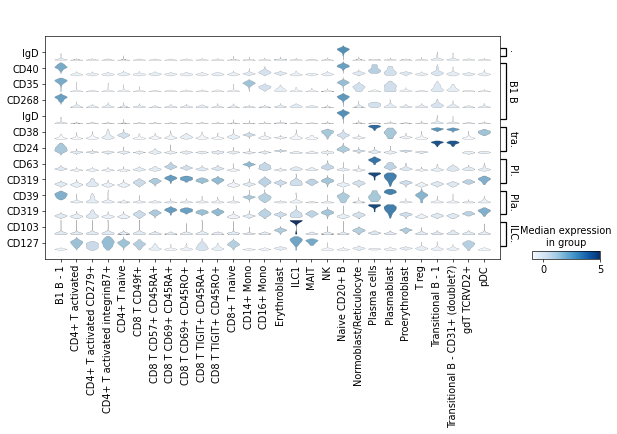

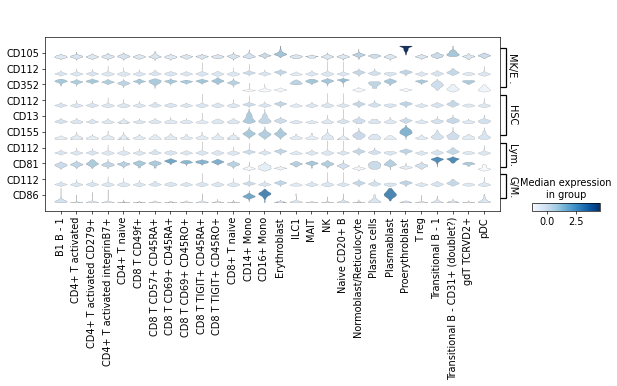

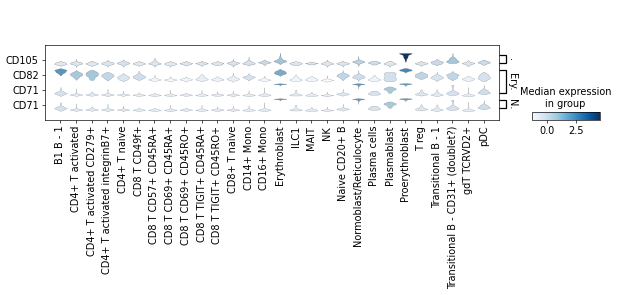

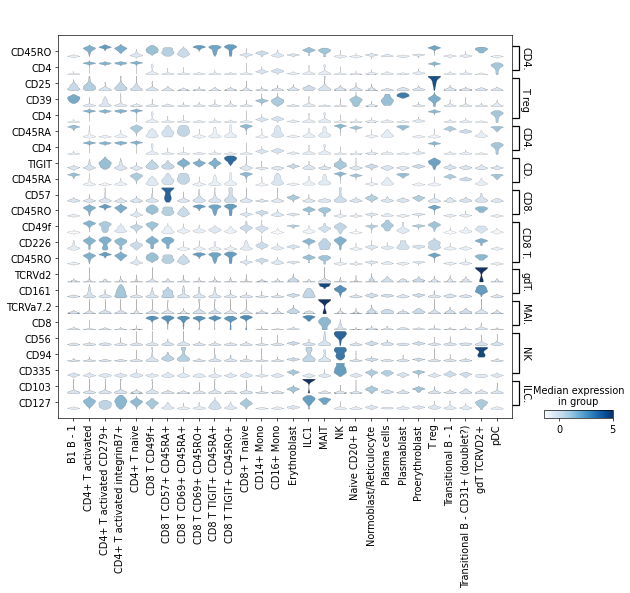

In [278]:
#Overview
adata_plot = adata_adt_filt.copy()
sc.pp.scale(adata_plot, max_value=5)

#Monocytes
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_prots[a] for a in ['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDC']})

#B cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_prots[a] for a in ['naive CD20+ B', 'B1 B', 'transitional B', 'Plasma cell', 'Plasmablast', 'ILC1']})

#Progenitors
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_prots[a] for a in ['MK/E prog', 'HSC', 'Lymph prog', 'G/M prog']})

#Erythropoiesis
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_prots[a] for a in ['Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte']})


#T & NK cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_prots[a] for a in ['CD4+ T activated', 'T reg', 'CD4+ T naive', 'CD8 T TIGIT+ CD45RA+', 'CD8 T CD57+ CD45RO+', 'CD8 T CD49f+', 'gdT TCRVD2+', 'MAIT', 'NK', 'ILC1']})



# Write output

In [387]:
adata_adt_filt

View of AnnData object with n_obs × n_vars = 8058 × 140
    obs: 'n_antibodies_by_counts', 'log1p_n_antibodies_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_5_antibodies', 'pct_counts_in_top_10_antibodies', 'iso_count', 'iso_count_col', 'log_iso_count', 'iso_count_fltr', 'n_counts', 'leiden', 'leiden_res0.3', 'leiden_res0.5', 'leiden_res0.8', 'leiden_res1', 'doublet_score', 'predicted_doublet', 'leiden_res0.5_sub', 'leiden_temp', 'leiden_final'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'iso_count_fltr_colors', 'pca', 'neighbors', 'leiden', 'umap', 'leiden_res0.3_colors', 'leiden_res0.5_colors', 'leiden_res0.8_colors', 'leiden_res1_colors', 'predicted_doublet_colors', 'rank_leiden_res0.5', 'leiden_res0.5_sub_colors', 'leiden_temp_colors', 'leiden_final_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp

In [388]:
adata_adt_filt_slim = adata_adt_filt.copy()

In [389]:
adata_adt_filt_slim.obs = adata_adt_filt_slim.obs[['n_antibodies_by_counts', 'total_counts', 'iso_count',
                                                   'leiden_res0.5_sub', 'leiden_final']]

adata_adt_filt_slim.var = adata_adt_filt_slim.var[['gene_ids', 'feature_types', 'genome', 'n_cells_by_counts']]

In [390]:
adata_adt_filt_slim

AnnData object with n_obs × n_vars = 8058 × 140
    obs: 'n_antibodies_by_counts', 'total_counts', 'iso_count', 'leiden_res0.5_sub', 'leiden_final'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts'
    uns: 'iso_count_fltr_colors', 'pca', 'neighbors', 'leiden', 'umap', 'leiden_res0.3_colors', 'leiden_res0.5_colors', 'leiden_res0.8_colors', 'leiden_res1_colors', 'predicted_doublet_colors', 'rank_leiden_res0.5', 'leiden_res0.5_sub_colors', 'leiden_temp_colors', 'leiden_final_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [391]:
adata_adt_filt_slim.write('data/s1d1/cite/s1d1_ADT_unmerged.h5ad')